In [ ]:
# Snippet 1 Install required libraries
!pip install rasterio openai matplotlib

# Mount Google Drive to access files
from google.colab import drive
drive.mount('/content/drive')

print("Libraries installed and Google Drive mounted.")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Libraries installed and Google Drive mounted.


In [ ]:
#Snippet 2
import openai
from google.colab import userdata

# Access your OpenAI API key from Colab Secrets
OPENAI_API_KEY = userdata.get('OPENAI_API_KEY')

if OPENAI_API_KEY is None:
    print("ERROR: OPENAI_API_KEY not found in Colab Secrets. Please add it.")
else:
    # Initialize the OpenAI client (for openai library version > 1.0)
    client = openai.OpenAI(api_key=OPENAI_API_KEY)
    print("OpenAI API client configured successfully.")

OpenAI API client configured successfully.


Dataset opened successfully!
Dataset ID (for logging): SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)
File opened: /content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_color-relief.tif
--- Metadata ---
CRS: EPSG:4326
Bounds: BoundingBox(left=-53.70013888887216, bottom=-12.399861111120698, right=-53.2001388888721, top=-11.999861111120644)
Width: 1800 pixels, Height: 1440 pixels
Number of bands: 3
Data type of first band: uint8

--- Basic Visualization (Band 1) ---


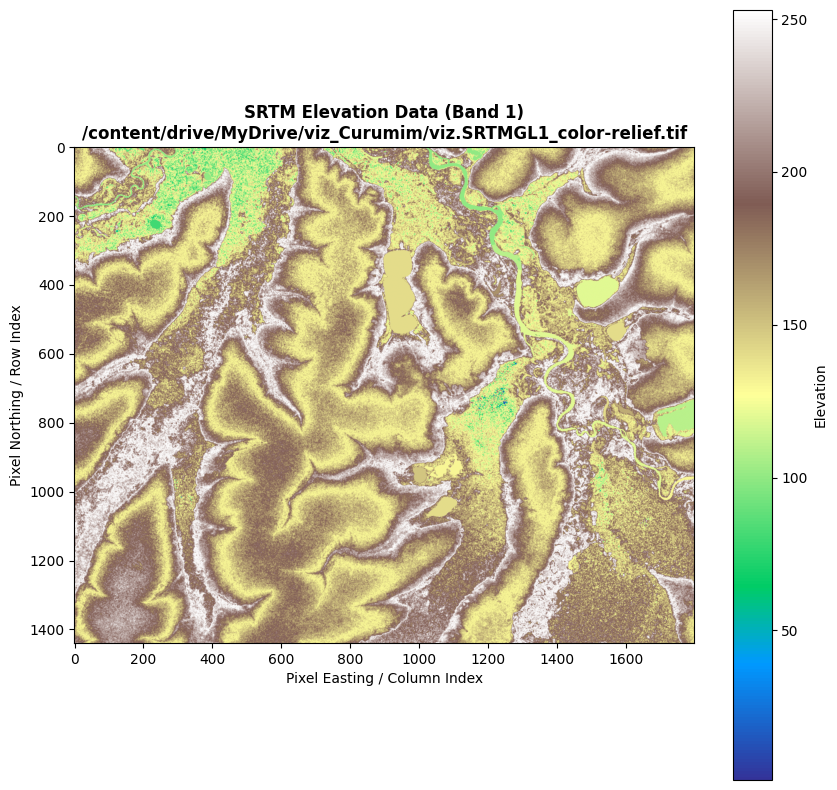


--- Basic Statistics (Band 1) ---
Using NoData value from metadata: 0.0
Min elevation: 1
Max elevation: 253
Mean elevation: 173.64867283950616


In [ ]:
# Snippet 3 - Curumim: Load and Inspect SRTM GeoTIFF Data(1 of 4)

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# IMPORTANT: Replace with the actual path to your GeoTIFF file in Google Drive
# This should be your main DEM file, likely named 'output_SRTMGL1.tif' or similar.
# Example: '/content/drive/MyDrive/OpenAI_Z_Challenge_Data/output_SRTMGL1.tif'
file_path = '/content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_color-relief.tif' # <<< --- UPDATE THIS LINE

# This is for your Checkpoint 1 logging, based on your previous info
dataset_id_from_source = "SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)"

try:
    with rasterio.open(file_path) as src:
        print("Dataset opened successfully!")
        print(f"Dataset ID (for logging): {dataset_id_from_source}")
        print(f"File opened: {file_path}")
        print("--- Metadata ---")
        print(f"CRS: {src.crs}")
        print(f"Bounds: {src.bounds}")
        print(f"Width: {src.width} pixels, Height: {src.height} pixels")
        print(f"Number of bands: {src.count}")
        if src.count > 0:
            print(f"Data type of first band: {src.dtypes[0]}")
        else:
            print("No bands found in the dataset.")

        # Proceed only if there's at least one band
        if src.count > 0:
            # Read the first band (assuming elevation data is in the first band)
            data_band1 = src.read(1)

            # Basic visualization of the first band
            print("\n--- Basic Visualization (Band 1) ---")
            fig, ax = plt.subplots(1, 1, figsize=(10, 10)) # Increased figure size for better viewing
            show(data_band1, ax=ax, cmap='terrain', title=f'SRTM Elevation Data (Band 1)\n{file_path}')
            ax.set_xlabel("Pixel Easting / Column Index") # More descriptive labels
            ax.set_ylabel("Pixel Northing / Row Index")
            plt.colorbar(ax.images[0], ax=ax, label="Elevation") # Add a colorbar
            plt.show()

            print("\n--- Basic Statistics (Band 1) ---")
            # Attempt to use the actual NoData value from the raster's metadata
            nodata_val = src.nodata

            # If nodata is not set in metadata, you might need to know it or infer it.
            # For SRTM, it's often -32768 for the 16-bit integer version.
            # We'll check if it's None and use a common SRTM NoData if so.
            if nodata_val is None:
                print("Warning: NoData value not explicitly set in raster metadata. Assuming a common value if applicable (e.g., -32768 for SRTM int16).")
                # For this example, if nodata_val is None, we won't specifically filter,
                # as np.min/max/mean on the raw array will be calculated.
                # For more robust stats, ensure you know and handle the NoData value correctly.
                valid_data_for_stats = data_band1 # Use all data if nodata is not specified
            else:
                print(f"Using NoData value from metadata: {nodata_val}")
                valid_data_for_stats = data_band1[data_band1 != nodata_val]

            if valid_data_for_stats.size > 0:
                print(f"Min elevation: {valid_data_for_stats.min()}")
                print(f"Max elevation: {valid_data_for_stats.max()}")
                print(f"Mean elevation: {valid_data_for_stats.mean()}")
            else:
                # This case might occur if the entire array consists of NoData values,
                # or if nodata_val was None and data_band1 was empty (though src.read(1) would usually error earlier).
                print("No valid data found to calculate statistics (array might be empty or all NoData values).")
        else:
            print("Cannot perform analysis as no bands were found in the dataset.")

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'.")
    print("Please ensure:")
    print("1. You have downloaded the correct GeoTIFF file (e.g., 'output_SRTMGL1.tif').")
    print("2. You have uploaded it to your Google Drive.")
    print("3. The 'file_path' variable in this script accurately points to its location in your Google Drive.")
    print("   Example: '/content/drive/MyDrive/YourFolder/YourFile.tif'")
except rasterio.errors.RasterioIOError as e:
    print(f"ERROR: Could not open or read the raster file at '{file_path}'.")
    print(f"The file might be corrupted, not a valid GeoTIFF, or an issue with permissions.")
    print(f"Rasterio error: {e}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")
    print("Make sure the file path is correct and the file is a valid GeoTIFF.")

Dataset opened successfully!
Dataset ID (for logging): SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)
File opened: /content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade-color.tif
--- Metadata ---
CRS: EPSG:4326
Bounds: BoundingBox(left=-53.70013888887216, bottom=-12.399861111120698, right=-53.2001388888721, top=-11.999861111120644)
Width: 1800 pixels, Height: 1440 pixels
Number of bands: 3
Data type of first band: uint8

--- Basic Visualization (Band 1) ---


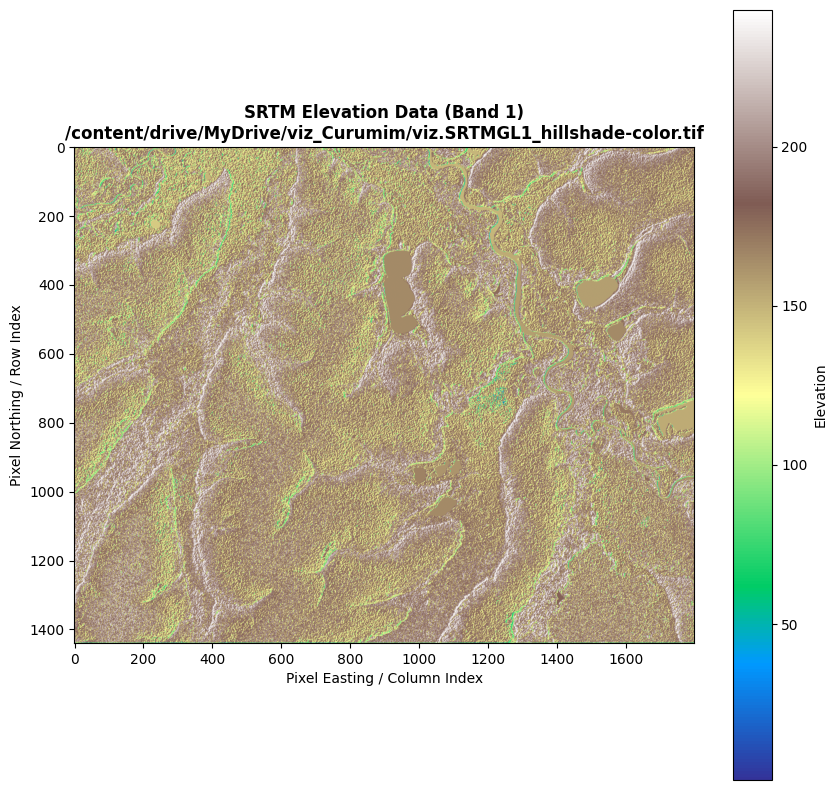


--- Basic Statistics (Band 1) ---
Using NoData value from metadata: 0.0
Min elevation: 1
Max elevation: 243
Mean elevation: 170.19202083333334


In [ ]:
# Snippet 3 - Curumim: Load and Inspect SRTM GeoTIFF Data(2 of 4)

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# IMPORTANT: Replace with the actual path to your GeoTIFF file in Google Drive
# This should be your main DEM file, likely named 'output_SRTMGL1.tif' or similar.
# Example: '/content/drive/MyDrive/OpenAI_Z_Challenge_Data/output_SRTMGL1.tif'
file_path = '/content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade-color.tif' # <<< --- UPDATE THIS LINE

# This is for your Checkpoint 1 logging, based on your previous info
dataset_id_from_source = "SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)"

try:
    with rasterio.open(file_path) as src:
        print("Dataset opened successfully!")
        print(f"Dataset ID (for logging): {dataset_id_from_source}")
        print(f"File opened: {file_path}")
        print("--- Metadata ---")
        print(f"CRS: {src.crs}")
        print(f"Bounds: {src.bounds}")
        print(f"Width: {src.width} pixels, Height: {src.height} pixels")
        print(f"Number of bands: {src.count}")
        if src.count > 0:
            print(f"Data type of first band: {src.dtypes[0]}")
        else:
            print("No bands found in the dataset.")

        # Proceed only if there's at least one band
        if src.count > 0:
            # Read the first band (assuming elevation data is in the first band)
            data_band1 = src.read(1)

            # Basic visualization of the first band
            print("\n--- Basic Visualization (Band 1) ---")
            fig, ax = plt.subplots(1, 1, figsize=(10, 10)) # Increased figure size for better viewing
            show(data_band1, ax=ax, cmap='terrain', title=f'SRTM Elevation Data (Band 1)\n{file_path}')
            ax.set_xlabel("Pixel Easting / Column Index") # More descriptive labels
            ax.set_ylabel("Pixel Northing / Row Index")
            plt.colorbar(ax.images[0], ax=ax, label="Elevation") # Add a colorbar
            plt.show()

            print("\n--- Basic Statistics (Band 1) ---")
            # Attempt to use the actual NoData value from the raster's metadata
            nodata_val = src.nodata

            # If nodata is not set in metadata, you might need to know it or infer it.
            # For SRTM, it's often -32768 for the 16-bit integer version.
            # We'll check if it's None and use a common SRTM NoData if so.
            if nodata_val is None:
                print("Warning: NoData value not explicitly set in raster metadata. Assuming a common value if applicable (e.g., -32768 for SRTM int16).")
                # For this example, if nodata_val is None, we won't specifically filter,
                # as np.min/max/mean on the raw array will be calculated.
                # For more robust stats, ensure you know and handle the NoData value correctly.
                valid_data_for_stats = data_band1 # Use all data if nodata is not specified
            else:
                print(f"Using NoData value from metadata: {nodata_val}")
                valid_data_for_stats = data_band1[data_band1 != nodata_val]

            if valid_data_for_stats.size > 0:
                print(f"Min elevation: {valid_data_for_stats.min()}")
                print(f"Max elevation: {valid_data_for_stats.max()}")
                print(f"Mean elevation: {valid_data_for_stats.mean()}")
            else:
                # This case might occur if the entire array consists of NoData values,
                # or if nodata_val was None and data_band1 was empty (though src.read(1) would usually error earlier).
                print("No valid data found to calculate statistics (array might be empty or all NoData values).")
        else:
            print("Cannot perform analysis as no bands were found in the dataset.")

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'.")
    print("Please ensure:")
    print("1. You have downloaded the correct GeoTIFF file (e.g., 'output_SRTMGL1.tif').")
    print("2. You have uploaded it to your Google Drive.")
    print("3. The 'file_path' variable in this script accurately points to its location in your Google Drive.")
    print("   Example: '/content/drive/MyDrive/YourFolder/YourFile.tif'")
except rasterio.errors.RasterioIOError as e:
    print(f"ERROR: Could not open or read the raster file at '{file_path}'.")
    print(f"The file might be corrupted, not a valid GeoTIFF, or an issue with permissions.")
    print(f"Rasterio error: {e}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")
    print("Make sure the file path is correct and the file is a valid GeoTIFF.")

Dataset opened successfully!
Dataset ID (for logging): SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)
File opened: /content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_slope.tif
--- Metadata ---
CRS: EPSG:4326
Bounds: BoundingBox(left=-53.70013888887216, bottom=-12.399861111120698, right=-53.2001388888721, top=-11.999861111120644)
Width: 1800 pixels, Height: 1440 pixels
Number of bands: 1
Data type of first band: float32

--- Basic Visualization (Band 1) ---


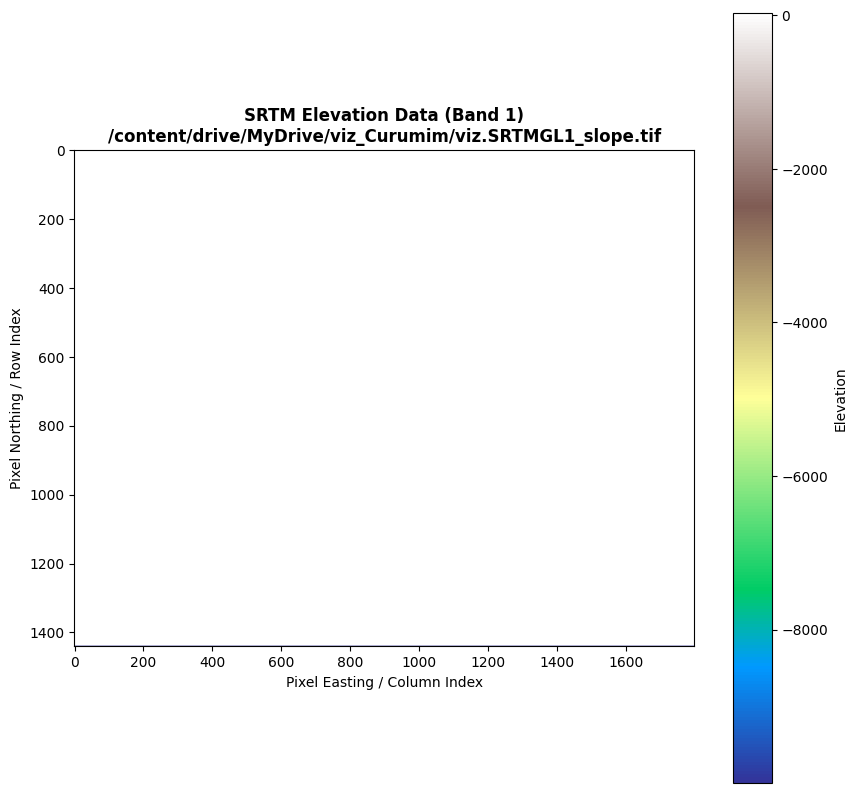


--- Basic Statistics (Band 1) ---
Using NoData value from metadata: -9999.0
Min elevation: 0.0
Max elevation: 29.238542556762695
Mean elevation: 2.0792946815490723


In [ ]:
# Snippet 3 - Curumim: Load and Inspect SRTM GeoTIFF Data(3 of 4)

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# IMPORTANT: Replace with the actual path to your GeoTIFF file in Google Drive
# This should be your main DEM file, likely named 'output_SRTMGL1.tif' or similar.
# Example: '/content/drive/MyDrive/OpenAI_Z_Challenge_Data/output_SRTMGL1.tif'
file_path = '/content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_slope.tif' # <<< --- UPDATE THIS LINE

# This is for your Checkpoint 1 logging, based on your previous info
dataset_id_from_source = "SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)"

try:
    with rasterio.open(file_path) as src:
        print("Dataset opened successfully!")
        print(f"Dataset ID (for logging): {dataset_id_from_source}")
        print(f"File opened: {file_path}")
        print("--- Metadata ---")
        print(f"CRS: {src.crs}")
        print(f"Bounds: {src.bounds}")
        print(f"Width: {src.width} pixels, Height: {src.height} pixels")
        print(f"Number of bands: {src.count}")
        if src.count > 0:
            print(f"Data type of first band: {src.dtypes[0]}")
        else:
            print("No bands found in the dataset.")

        # Proceed only if there's at least one band
        if src.count > 0:
            # Read the first band (assuming elevation data is in the first band)
            data_band1 = src.read(1)

            # Basic visualization of the first band
            print("\n--- Basic Visualization (Band 1) ---")
            fig, ax = plt.subplots(1, 1, figsize=(10, 10)) # Increased figure size for better viewing
            show(data_band1, ax=ax, cmap='terrain', title=f'SRTM Elevation Data (Band 1)\n{file_path}')
            ax.set_xlabel("Pixel Easting / Column Index") # More descriptive labels
            ax.set_ylabel("Pixel Northing / Row Index")
            plt.colorbar(ax.images[0], ax=ax, label="Elevation") # Add a colorbar
            plt.show()

            print("\n--- Basic Statistics (Band 1) ---")
            # Attempt to use the actual NoData value from the raster's metadata
            nodata_val = src.nodata

            # If nodata is not set in metadata, you might need to know it or infer it.
            # For SRTM, it's often -32768 for the 16-bit integer version.
            # We'll check if it's None and use a common SRTM NoData if so.
            if nodata_val is None:
                print("Warning: NoData value not explicitly set in raster metadata. Assuming a common value if applicable (e.g., -32768 for SRTM int16).")
                # For this example, if nodata_val is None, we won't specifically filter,
                # as np.min/max/mean on the raw array will be calculated.
                # For more robust stats, ensure you know and handle the NoData value correctly.
                valid_data_for_stats = data_band1 # Use all data if nodata is not specified
            else:
                print(f"Using NoData value from metadata: {nodata_val}")
                valid_data_for_stats = data_band1[data_band1 != nodata_val]

            if valid_data_for_stats.size > 0:
                print(f"Min elevation: {valid_data_for_stats.min()}")
                print(f"Max elevation: {valid_data_for_stats.max()}")
                print(f"Mean elevation: {valid_data_for_stats.mean()}")
            else:
                # This case might occur if the entire array consists of NoData values,
                # or if nodata_val was None and data_band1 was empty (though src.read(1) would usually error earlier).
                print("No valid data found to calculate statistics (array might be empty or all NoData values).")
        else:
            print("Cannot perform analysis as no bands were found in the dataset.")

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'.")
    print("Please ensure:")
    print("1. You have downloaded the correct GeoTIFF file (e.g., 'output_SRTMGL1.tif').")
    print("2. You have uploaded it to your Google Drive.")
    print("3. The 'file_path' variable in this script accurately points to its location in your Google Drive.")
    print("   Example: '/content/drive/MyDrive/YourFolder/YourFile.tif'")
except rasterio.errors.RasterioIOError as e:
    print(f"ERROR: Could not open or read the raster file at '{file_path}'.")
    print(f"The file might be corrupted, not a valid GeoTIFF, or an issue with permissions.")
    print(f"Rasterio error: {e}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")
    print("Make sure the file path is correct and the file is a valid GeoTIFF.")

Dataset opened successfully!
Dataset ID (for logging): SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)
File opened: /content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade.tif
--- Metadata ---
CRS: EPSG:4326
Bounds: BoundingBox(left=-53.70013888887216, bottom=-12.399861111120698, right=-53.2001388888721, top=-11.999861111120644)
Width: 1800 pixels, Height: 1440 pixels
Number of bands: 1
Data type of first band: uint8

--- Basic Visualization (Band 1) ---
Click on the plot below to get geographic coordinates. Close the plot window when done.


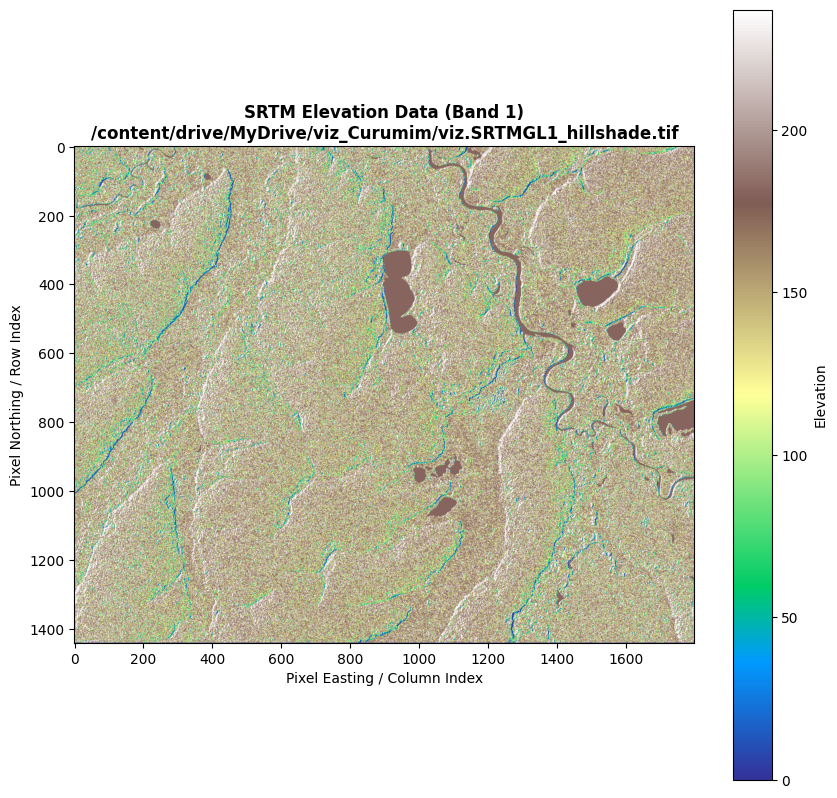


--- Basic Statistics (Band 1) ---
Using NoData value from metadata: 0.0
Min elevation: 1
Max elevation: 237
Mean elevation: 168.27766479831556


In [ ]:
# Snippet 3 - Curumim: Load and Inspect SRTM GeoTIFF Data(4 of 4)

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# IMPORTANT: Replace with the actual path to your GeoTIFF file in Google Drive
# This should be your main DEM file, likely named 'output_SRTMGL1.tif' or similar.
# Example: '/content/drive/MyDrive/OpenAI_Z_Challenge_Data/output_SRTMGL1.tif'
file_path = '/content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade.tif' # <<< --- UPDATE THIS LINE

# This is for your Checkpoint 1 logging, based on your previous info
dataset_id_from_source = "SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)"

try:
    with rasterio.open(file_path) as src:
        print("Dataset opened successfully!")
        print(f"Dataset ID (for logging): {dataset_id_from_source}")
        print(f"File opened: {file_path}")
        print("--- Metadata ---")
        print(f"CRS: {src.crs}")
        print(f"Bounds: {src.bounds}")
        print(f"Width: {src.width} pixels, Height: {src.height} pixels")
        print(f"Number of bands: {src.count}")
        if src.count > 0:
            print(f"Data type of first band: {src.dtypes[0]}")
        else:
            print("No bands found in the dataset.")

        # Proceed only if there's at least one band
        if src.count > 0:
            # Read the first band (assuming elevation data is in the first band)
            data_band1 = src.read(1)

            # Basic visualization of the first band
            print("\n--- Basic Visualization (Band 1) ---")
            fig, ax = plt.subplots(1, 1, figsize=(10, 10)) # Increased figure size for better viewing
            show(data_band1, ax=ax, cmap='terrain', title=f'SRTM Elevation Data (Band 1)\n{file_path}')
            ax.set_xlabel("Pixel Easting / Column Index") # More descriptive labels
            ax.set_ylabel("Pixel Northing / Row Index")
            plt.colorbar(ax.images[0], ax=ax, label="Elevation") # Add a colorbar
            onclick = get_coords_from_plot(src.transform)
            plt.show()


            print("\n--- Basic Statistics (Band 1) ---")
            # Attempt to use the actual NoData value from the raster's metadata
            nodata_val = src.nodata

            # If nodata is not set in metadata, you might need to know it or infer it.
            # For SRTM, it's often -32768 for the 16-bit integer version.
            # We'll check if it's None and use a common SRTM NoData if so.
            if nodata_val is None:
                print("Warning: NoData value not explicitly set in raster metadata. Assuming a common value if applicable (e.g., -32768 for SRTM int16).")
                # For this example, if nodata_val is None, we won't specifically filter,
                # as np.min/max/mean on the raw array will be calculated.
                # For more robust stats, ensure you know and handle the NoData value correctly.
                valid_data_for_stats = data_band1 # Use all data if nodata is not specified
            else:
                print(f"Using NoData value from metadata: {nodata_val}")
                valid_data_for_stats = data_band1[data_band1 != nodata_val]

            if valid_data_for_stats.size > 0:
                print(f"Min elevation: {valid_data_for_stats.min()}")
                print(f"Max elevation: {valid_data_for_stats.max()}")
                print(f"Mean elevation: {valid_data_for_stats.mean()}")
            else:
                # This case might occur if the entire array consists of NoData values,
                # or if nodata_val was None and data_band1 was empty (though src.read(1) would usually error earlier).
                print("No valid data found to calculate statistics (array might be empty or all NoData values).")
        else:
            print("Cannot perform analysis as no bands were found in the dataset.")

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'.")
    print("Please ensure:")
    print("1. You have downloaded the correct GeoTIFF file (e.g., 'output_SRTMGL1.tif').")
    print("2. You have uploaded it to your Google Drive.")
    print("3. The 'file_path' variable in this script accurately points to its location in your Google Drive.")
    print("   Example: '/content/drive/MyDrive/YourFolder/YourFile.tif'")
except rasterio.errors.RasterioIOError as e:
    print(f"ERROR: Could not open or read the raster file at '{file_path}'.")
    print(f"The file might be corrupted, not a valid GeoTIFF, or an issue with permissions.")
    print(f"Rasterio error: {e}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")
    print("Make sure the file path is correct and the file is a valid GeoTIFF.")

Dataset opened successfully!
Dataset ID (for logging): SRTM GL1 - OpenTopography JobId rt1749359231259 (Curumim Area)
File opened: /content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade.tif
--- Metadata ---
CRS: EPSG:4326
Bounds: BoundingBox(left=-53.70013888887216, bottom=-12.399861111120698, right=-53.2001388888721, top=-11.999861111120644)
Width: 1800 pixels, Height: 1440 pixels
Number of bands: 1
Data type of first band: uint8

--- Interactive Hillshade Visualization: Click on a feature to get its coordinates ---


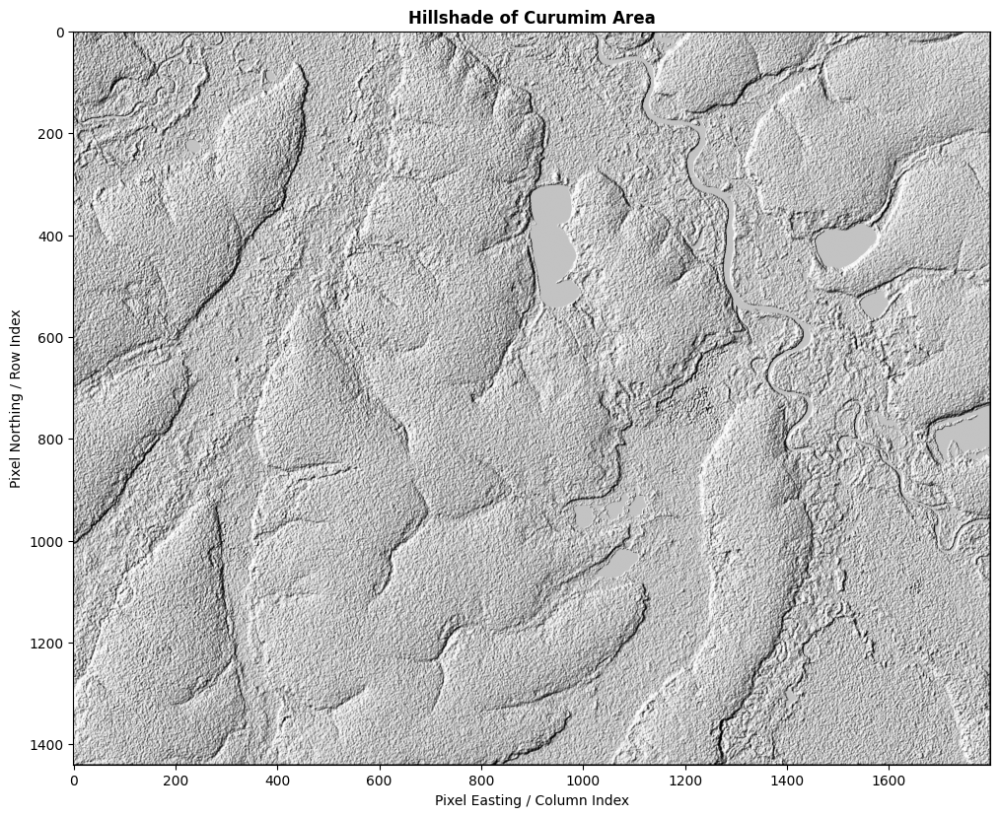

In [ ]:
# --- Snippet to Visualize a Hillshade File Interactively ---
## Set up For Image visuals for Checkpoint 1 Submission 1 of


import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# --- 1. UPDATE THIS LINE ---
# Make sure this is the correct path to your NEW hillshade file in Google Drive.
# Get it by right-clicking the file in the Colab file browser and choosing 'Copy path'.
file_path = '/content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade.tif' # <<<--- UPDATE IF NEEDED

# This is for your Checkpoint 1 logging. Remember to update with the new Job ID.
dataset_id_from_source = "SRTM GL1 - OpenTopography JobId rt1749359231259 (Curumim Area)"

# This is the interactive click function from our toolkit.
# Ensure the cell containing this function has been run first.
def get_coords_from_plot(transform):
    def onclick(event):
        if event.xdata is not None and event.ydata is not None:
            pixel_x, pixel_y = int(event.xdata), int(event.ydata)
            lon, lat = transform * (pixel_x, pixel_y)
            print(f"📍 Clicked! Anomaly Candidate at: (Latitude: {lat:.6f}, Longitude: {lon:.6f})")
    return onclick

try:
    with rasterio.open(file_path) as src:
        print("Dataset opened successfully!")
        print(f"Dataset ID (for logging): {dataset_id_from_source}")
        print(f"File opened: {file_path}")
        print("--- Metadata ---")
        print(f"CRS: {src.crs}")
        print(f"Bounds: {src.bounds}")
        print(f"Width: {src.width} pixels, Height: {src.height} pixels")
        print(f"Number of bands: {src.count}")
        print(f"Data type of first band: {src.dtypes[0]}")

        # Read the first band of the hillshade
        data_band1 = src.read(1)

        # --- Interactive Visualization ---
        print("\n--- Interactive Hillshade Visualization: Click on a feature to get its coordinates ---")
        fig, ax = plt.subplots(1, 1, figsize=(12, 12))

        # Show the hillshade using the CORRECT grayscale color map
        show(data_band1, ax=ax, cmap='gray', title='Hillshade of Curumim Area')
        ax.set_xlabel("Pixel Easting / Column Index")
        ax.set_ylabel("Pixel Northing / Row Index")

        # Create the click handler using our function and the raster's transform
        onclick = get_coords_from_plot(src.transform)

        # Display the plot
        plt.show()

        # Connect the click function to the plot so it becomes interactive
        fig.canvas.mpl_connect('button_press_event', onclick)

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'. Please check the path.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

--- Interactive Hillshade Visualization ---
Dataset opened successfully!
File: /content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade.tif
CRS: EPSG:4326


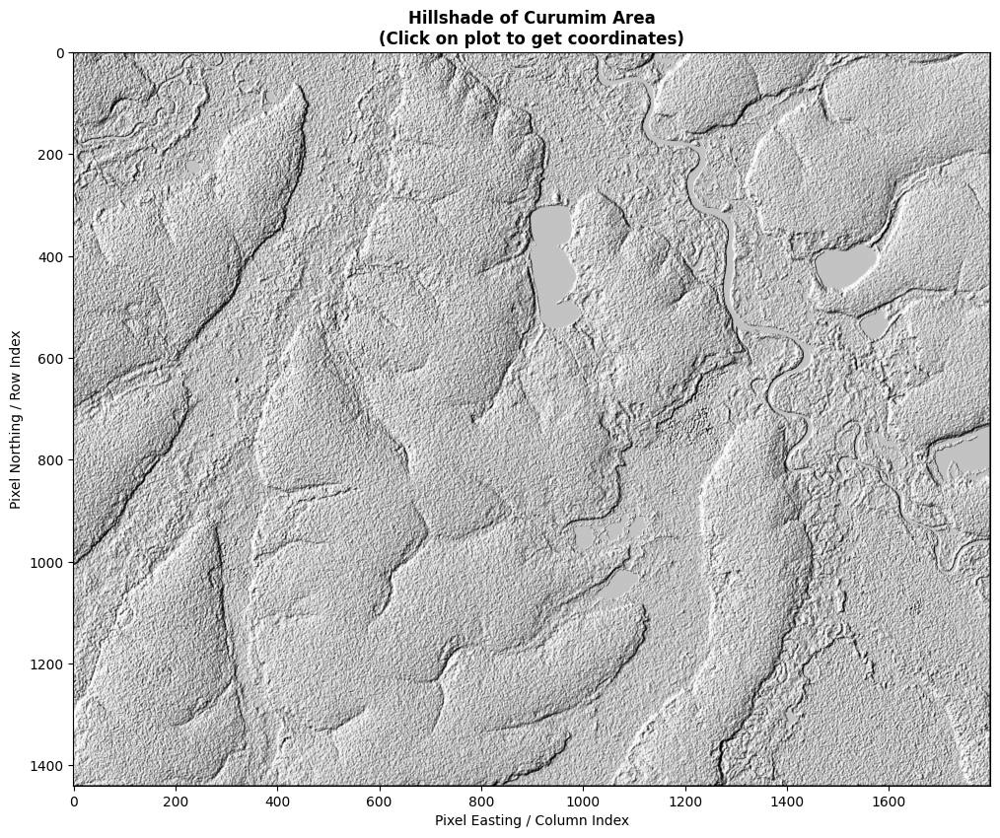

In [ ]:
# --- Snippet for Interactive Hillshade Visualization ---
## Set up For Image visuals for Checkpoint 1 Submission 2 of

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# --- 1. UPDATE THIS LINE ---
# Make sure this is the correct path to your NEW hillshade file in Google Drive
# You can get it by right-clicking the file in the Colab file browser and choosing 'Copy path'
file_path = '/content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade.tif' # <<<--- UPDATE IF NEEDED

# This is the interactive click function from our toolkit
def get_coords_from_plot(transform):
    def onclick(event):
        if event.xdata is not None and event.ydata is not None:
            pixel_x, pixel_y = int(event.xdata), int(event.ydata)
            lon, lat = transform * (pixel_x, pixel_y)
            print(f"📍 Clicked! Anomaly Candidate at: (Latitude: {lat:.6f}, Longitude: {lon:.6f})")
    return onclick

# --- Main analysis and plotting ---
try:
    with rasterio.open(file_path) as src:
        print("--- Interactive Hillshade Visualization ---")
        print("Dataset opened successfully!")
        print(f"File: {file_path}")
        print(f"CRS: {src.crs}")

        # Read the first band of the hillshade
        data_band1 = src.read(1)

        # Create the plot
        fig, ax = plt.subplots(1, 1, figsize=(12, 12)) # Made the plot bigger for easier searching

        # Show the hillshade using a grayscale color map, which is correct for this data
        show(data_band1, ax=ax, cmap='gray', title=f'Hillshade of Curumim Area\n(Click on plot to get coordinates)')
        ax.set_xlabel("Pixel Easting / Column Index")
        ax.set_ylabel("Pixel Northing / Row Index")

        # Create the click handler using our function and the raster's transform
        onclick = get_coords_from_plot(src.transform)

        # Display the plot
        plt.show()

        # Connect the click function to the plot so it becomes interactive
        fig.canvas.mpl_connect('button_press_event', onclick)

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'. Please check the path and make sure the file is uploaded to your Google Drive.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

Generating annotated map for southern anomalies...


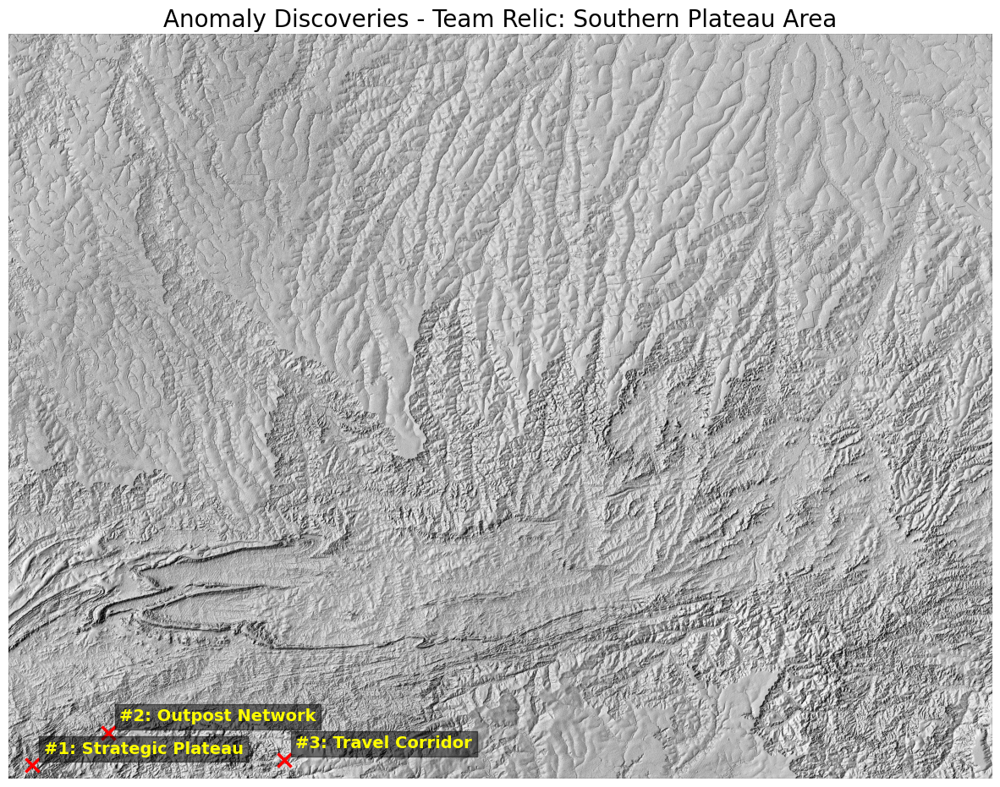

In [ ]:
# --- Snippet for Creating the Annotated Map of Southern Anomalies ---
## Set up For Image visuals for Checkpoint 1 Submission 3 of (Take 1)

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# --- 1. UPDATE THIS LINE ---
# Make sure this is the correct path to your ORIGINAL, LARGE hillshade file
file_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/viz/viz.SRTMGL1_hillshade.tif' # <<<--- UPDATE IF NEEDED

# --- 2. Anomaly Data to Plot ---
# We are plotting the anomalies from the southern region of your original dataset
anomalies_to_plot = [
    {
        "name": "#1: Strategic Plateau",
        "coords": (-15.07, -56.13)  # (Lat, Lon)
    },
    {
        "name": "#2: Outpost Network",
        "coords": (-14.95, -55.85)  # (Lat, Lon) - We'll plot one representative outpost
    },
    {
        "name": "#3: Travel Corridor",
        "coords": (-15.05, -55.20)  # (Lat, Lon) - We'll plot the start of the corridor
    }
]

print("Generating annotated map for southern anomalies...")

try:
    with rasterio.open(file_path) as src:
        # Get the inverse transform to convert from Lat/Lon to Pixel coordinates
        inv_transform = ~src.transform

        # Read the hillshade data
        hillshade_data = src.read(1)

        # Create the plot
        fig, ax = plt.subplots(1, 1, figsize=(15, 15))

        # Plot the base hillshade map
        show(hillshade_data, ax=ax, cmap='gray')

        # --- Loop through each anomaly to plot it ---
        for anomaly in anomalies_to_plot:
            lat, lon = anomaly["coords"]
            pixel_x, pixel_y = inv_transform * (lon, lat)

            if 0 <= pixel_x < src.width and 0 <= pixel_y < src.height:
                # Plot a bright red 'X' as the "pin"
                ax.plot(pixel_x, pixel_y, 'rx', markersize=12, markeredgewidth=2.5)

                # Add the text label slightly offset from the pin
                ax.text(pixel_x + 150, pixel_y - 150, anomaly["name"],  # Increased offset for the larger map
                        color='yellow',
                        fontsize=14,
                        fontweight='bold',
                        bbox=dict(facecolor='black', alpha=0.5))

        ax.set_title("Anomaly Discoveries - Team Relic: Southern Plateau Area", fontsize=20)
        ax.set_axis_off()
        plt.show()

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'. Please check the path to your ORIGINAL hillshade file.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

Generating final professional map with top-right, multi-border legend...


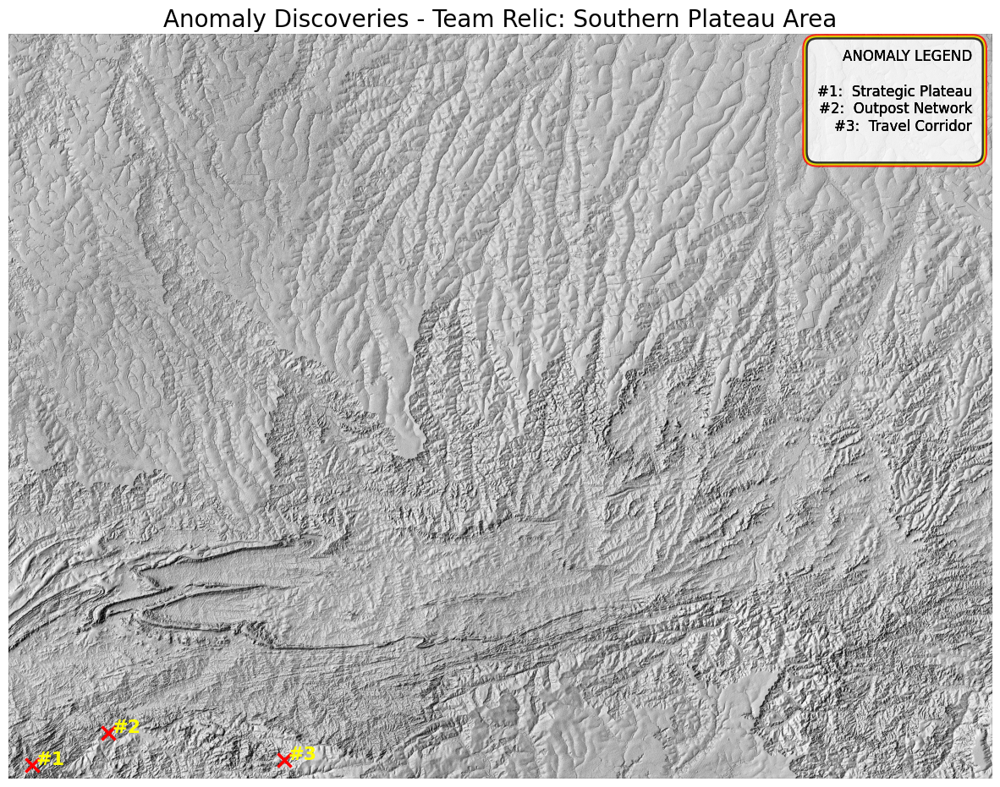

In [ ]:
# --- Snippet for Creating the Annotated Map of Southern Anomalies WITH CONNECTING LINES ---
## Set up For Image visuals for Checkpoint 1 Submission 3 of (Take 2)

# --- Snippet for Creating the Final Annotated Map with a Top-Right, Multi-Border Legend ---

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# --- 1. UPDATE THIS LINE ---
# Make sure this is the correct path to your ORIGINAL, LARGE hillshade file
file_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/viz/viz.SRTMGL1_hillshade.tif' # <<<--- UPDATE IF NEEDED

# --- 2. Anomaly Data to Plot ---
anomalies_to_plot = [
    {
        "id": "#1",
        "name": " Strategic Plateau",
        "coords": (-15.07, -56.13)  # (Lat, Lon)
    },
    {
        "id": "#2",
        "name": " Outpost Network",
        "coords": (-14.95, -55.85)  # (Lat, Lon)
    },
    {
        "id": "#3",
        "name": " Travel Corridor",
        "coords": (-15.05, -55.20)  # (Lat, Lon)
    }
]

print("Generating final professional map with top-right, multi-border legend...")

try:
    with rasterio.open(file_path) as src:
        inv_transform = ~src.transform
        hillshade_data = src.read(1)
        fig, ax = plt.subplots(1, 1, figsize=(15, 15))
        show(hillshade_data, ax=ax, cmap='gray')

        # --- Plot the numbered 'X' markers ---
        for anomaly in anomalies_to_plot:
            lat, lon = anomaly["coords"]
            pixel_x, pixel_y = inv_transform * (lon, lat)

            if 0 <= pixel_x < src.width and 0 <= pixel_y < src.height:
                ax.plot(pixel_x, pixel_y, 'rx', markersize=12, markeredgewidth=2.5)
                ax.text(pixel_x + 50, pixel_y, anomaly["id"], color='yellow', fontsize=16, fontweight='bold')

        # --- Create the Legend in the Top-Right Corner with Multi-Border ---
        legend_text = "ANOMALY LEGEND\n\n"
        for anomaly in anomalies_to_plot:
            legend_text += f"{anomaly['id']}: {anomaly['name']}\n"

        # Legend position (top-right)
        props = dict(boxstyle='round,pad=0.8', facecolor='white', alpha=0.8, edgecolor='black', linewidth=3)
        ax.text(0.98, 0.98, legend_text, transform=ax.transAxes, fontsize=12,
                verticalalignment='top', horizontalalignment='right', bbox=props)

        # Adding the yellow and red inner borders (using a bit of a trick)
        props_yellow = dict(boxstyle='round,pad=0.9', facecolor='none', alpha=0.8, edgecolor='yellow', linewidth=2)
        ax.text(0.98, 0.98, legend_text, transform=ax.transAxes, fontsize=12,
                verticalalignment='top', horizontalalignment='right', bbox=props_yellow)

        props_red = dict(boxstyle='round,pad=1.0', facecolor='none', alpha=0.8, edgecolor='red', linewidth=1.5)
        ax.text(0.98, 0.98, legend_text, transform=ax.transAxes, fontsize=12,
                verticalalignment='top', horizontalalignment='right', bbox=props_red)


        ax.set_title("Anomaly Discoveries - Team Relic: Southern Plateau Area", fontsize=20)
        ax.set_axis_off()
        plt.show()

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'. Please check the path.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

Generating final annotated anomaly map...


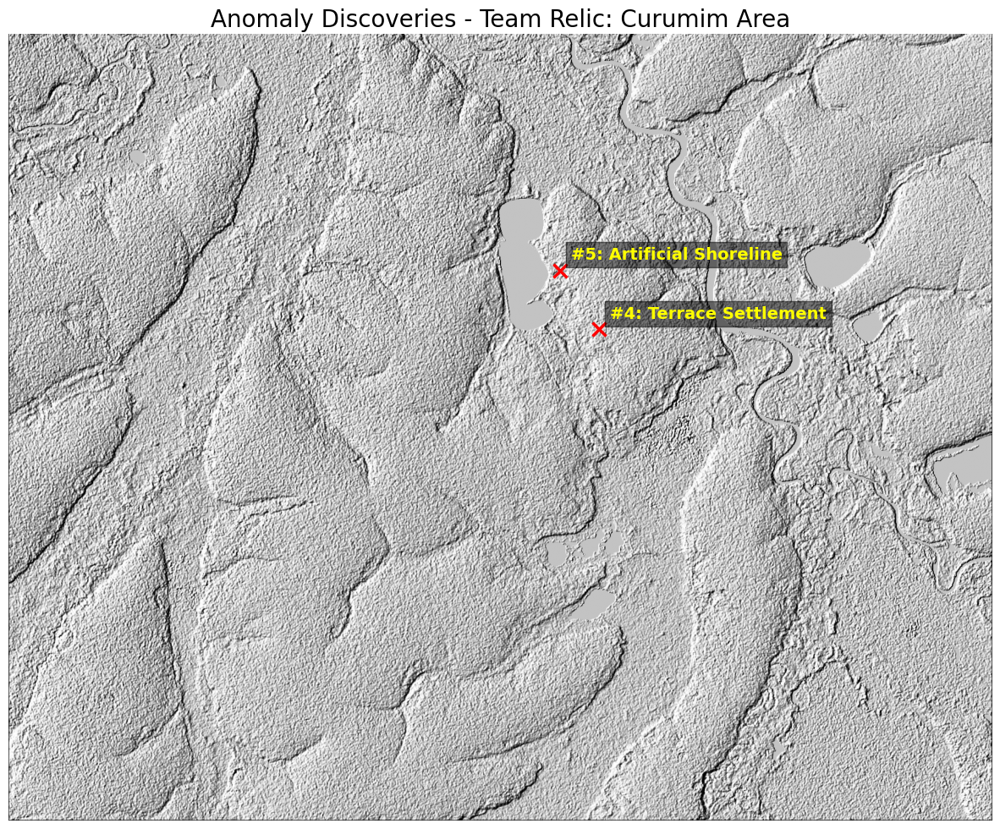

In [ ]:
# --- Snippet for Creating the Final Annotated Anomaly Map ---

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# --- 1. UPDATE THIS LINE ---
# Make sure this is the correct path to your NEW hillshade file for the Curumim Area
file_path = '/content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade.tif' # <<<--- UPDATE IF NEEDED

# --- 2. Anomaly Data to Plot ---
# We will plot the anomalies that are inside this specific map view
anomalies_to_plot = [
    {
        "name": "#4: Terrace Settlement",
        "coords": (-12.15, -53.40)  # (Lat, Lon)
    },
    {
        "name": "#5: Artificial Shoreline",
        "coords": (-12.12, -53.42)  # (Lat, Lon)
    }
]

print("Generating final annotated anomaly map...")

try:
    with rasterio.open(file_path) as src:
        # Get the inverse transform to convert from Lat/Lon to Pixel coordinates
        inv_transform = ~src.transform

        # Read the hillshade data
        hillshade_data = src.read(1)

        # Create the plot
        fig, ax = plt.subplots(1, 1, figsize=(15, 15)) # A large, high-quality figure

        # Plot the base hillshade map
        show(hillshade_data, ax=ax, cmap='gray')

        # --- Loop through each anomaly to plot it ---
        for anomaly in anomalies_to_plot:
            # Get the geographic coordinates
            lat, lon = anomaly["coords"]

            # Convert the geographic coords to pixel coords for plotting
            pixel_x, pixel_y = inv_transform * (lon, lat)

            # Check if the point is within the bounds of this specific map
            if 0 <= pixel_x < src.width and 0 <= pixel_y < src.height:
                # Plot a bright red 'X' as the "pin"
                ax.plot(pixel_x, pixel_y, 'rx', markersize=12, markeredgewidth=2.5)

                # Add the text label slightly offset from the pin
                ax.text(pixel_x + 20, pixel_y - 20, anomaly["name"],
                        color='yellow',
                        fontsize=14,
                        fontweight='bold',
                        bbox=dict(facecolor='black', alpha=0.5)) # Add a semi-transparent black box behind the text

        ax.set_title("Anomaly Discoveries - Team Relic: Curumim Area", fontsize=20)
        ax.set_axis_off() # Turn off the x/y axis for a clean map look
        plt.show()

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'. Please check the path.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

Generating final professional map for Curumim Area...


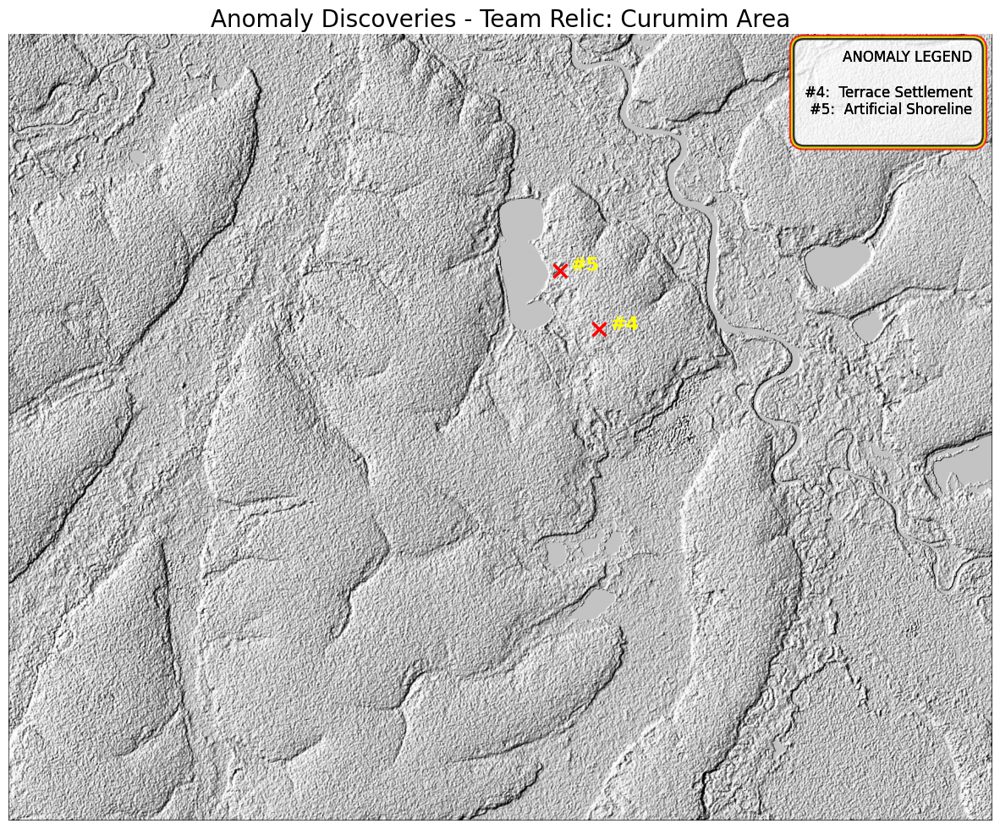

In [ ]:
# --- Snippet for Creating the Annotated Map of Curumim Area Anomalies ---

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# --- 1. UPDATE THIS LINE ---
# Make sure this is the correct path to your NEW hillshade file for the Curumim Area
file_path = '/content/drive/MyDrive/viz_Curumim/viz.SRTMGL1_hillshade.tif' # <<<--- UPDATE IF NEEDED

# --- 2. Anomaly Data to Plot ---
# We are plotting the anomalies that are inside this specific map view
anomalies_to_plot = [
    {
        "id": "#4",
        "name": " Terrace Settlement",
        "coords": (-12.15, -53.40)  # (Lat, Lon)
    },
    {
        "id": "#5",
        "name": " Artificial Shoreline",
        "coords": (-12.12, -53.42)  # (Lat, Lon)
    }
]

print("Generating final professional map for Curumim Area...")

try:
    with rasterio.open(file_path) as src:
        inv_transform = ~src.transform
        hillshade_data = src.read(1)
        fig, ax = plt.subplots(1, 1, figsize=(15, 15))
        show(hillshade_data, ax=ax, cmap='gray')

        # --- Plot the numbered 'X' markers ---
        for anomaly in anomalies_to_plot:
            lat, lon = anomaly["coords"]
            pixel_x, pixel_y = inv_transform * (lon, lat)

            if 0 <= pixel_x < src.width and 0 <= pixel_y < src.height:
                ax.plot(pixel_x, pixel_y, 'rx', markersize=12, markeredgewidth=2.5)
                ax.text(pixel_x + 20, pixel_y, anomaly["id"], color='yellow', fontsize=16, fontweight='bold') # Adjusted offset for this map scale

        # --- Create the Legend in the Top-Right Corner with Multi-Border ---
        legend_text = "ANOMALY LEGEND\n\n"
        for anomaly in anomalies_to_plot:
            legend_text += f"{anomaly['id']}: {anomaly['name']}\n"

        props = dict(boxstyle='round,pad=0.8', facecolor='white', alpha=0.8, edgecolor='black', linewidth=3)
        ax.text(0.98, 0.98, legend_text, transform=ax.transAxes, fontsize=12,
                verticalalignment='top', horizontalalignment='right', bbox=props)

        props_yellow = dict(boxstyle='round,pad=0.9', facecolor='none', alpha=0.8, edgecolor='yellow', linewidth=2)
        ax.text(0.98, 0.98, legend_text, transform=ax.transAxes, fontsize=12,
                verticalalignment='top', horizontalalignment='right', bbox=props_yellow)

        props_red = dict(boxstyle='round,pad=1.0', facecolor='none', alpha=0.8, edgecolor='red', linewidth=1.5)
        ax.text(0.98, 0.98, legend_text, transform=ax.transAxes, fontsize=12,
                verticalalignment='top', horizontalalignment='right', bbox=props_red)

        ax.set_title("Anomaly Discoveries - Team Relic: Curumim Area", fontsize=20)
        ax.set_axis_off()
        plt.show()

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'. Please check the path.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

Generating simple Sentinel-2 False-Color map...


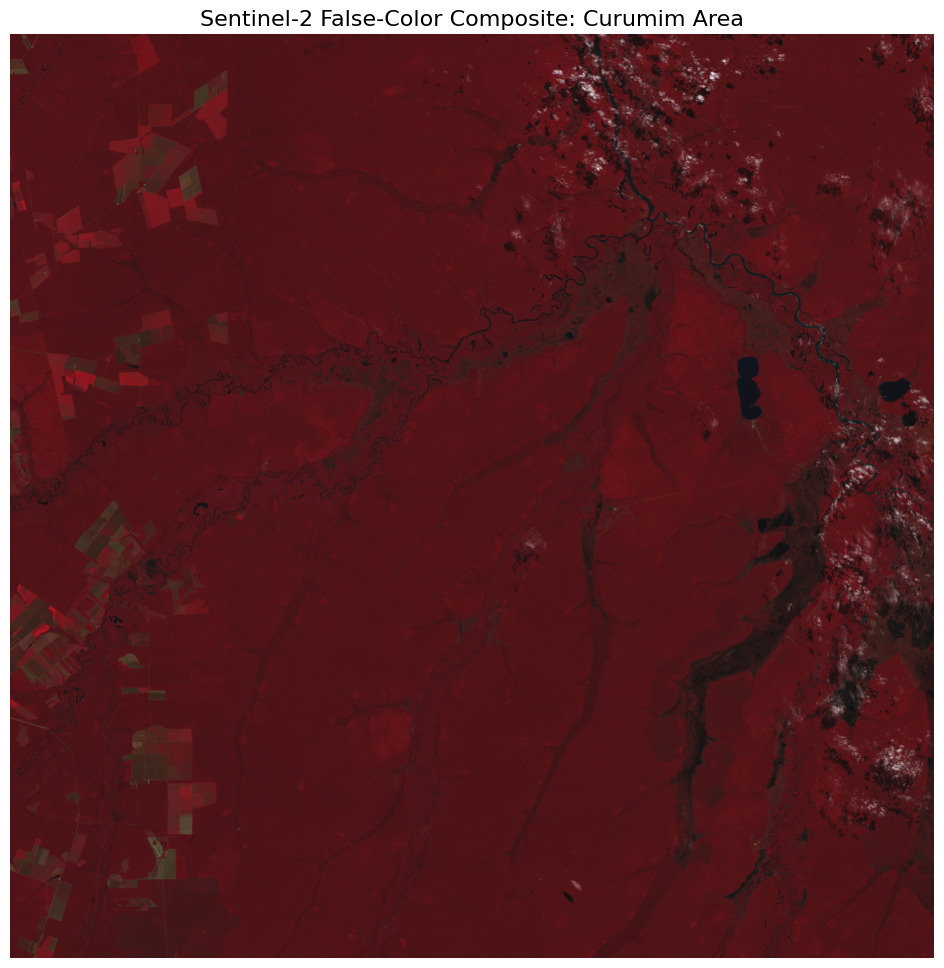

✅ Image generated successfully.


In [ ]:
# --- FINAL "JUST SHOW THE IMAGE" SNIPPET ---
# This is the simplest possible code to generate the Sentinel-2 False-Color image.

import rasterio
import matplotlib.pyplot as plt
import numpy as np

# --- Your file paths ---
b8_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m/Tile4_B08_10m.jp2'
b4_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m/Tile3_B04_10m.jp2'
b3_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m/Tile2_B03_10m.jp2'

print("Generating simple Sentinel-2 False-Color map...")

try:
    with rasterio.open(b8_path) as b8, rasterio.open(b4_path) as b4, rasterio.open(b3_path) as b3:

        # Load a low-resolution version to prevent crashes
        low_res_shape = (1, b8.height // 8, b8.width // 8)

        b8_data = b8.read(1, out_shape=low_res_shape, resampling=rasterio.enums.Resampling.bilinear)
        b4_data = b4.read(1, out_shape=low_res_shape, resampling=rasterio.enums.Resampling.bilinear)
        b3_data = b3.read(1, out_shape=low_res_shape, resampling=rasterio.enums.Resampling.bilinear)

        # Stack the bands
        false_color_composite = np.stack([b8_data, b4_data, b3_data])

        # Simple contrast stretch using min/max
        min_val, max_val = false_color_composite.min(), false_color_composite.max()
        if max_val > min_val:
            scaled_composite = (false_color_composite - min_val) / (max_val - min_val)
        else:
            scaled_composite = false_color_composite

        # Prepare for plotting
        plot_image = np.transpose(scaled_composite, (1, 2, 0))

        # --- Simple Plotting ---
        fig, ax = plt.subplots(1, 1, figsize=(12, 12))
        ax.imshow(plot_image)
        ax.set_title("Sentinel-2 False-Color Composite: Curumim Area", fontsize=16)
        ax.set_axis_off()
        plt.show()

        print("✅ Image generated successfully.")

except Exception as e:
    print(f"An error occurred: {e}")

In [ ]:
# --- Snippet to Show Southern Plateau Image with 'X' Markers ---

import rasterio
import matplotlib.pyplot as plt
import numpy as np

# --- 1. !! IMPORTANT: UPDATE THESE THREE PATHS !! ---
# These must point to your ORIGINAL (large area) Sentinel-2 band files.
b8_path = '/path/to/your/ORIGINAL_B08.jp2' # Near Infrared
b4_path = '/path/to/your/ORIGINAL_B04.jp2' # Red
b3_path = '/path/to/your/ORIGINAL_B03.jp2' # Green

# --- 2. Anomaly Data to Plot ---
anomalies_to_plot = [
    {"id": "1", "name": "#1: Strategic Plateau", "coords": (-15.07, -56.13)},
    {"id": "2", "name": "#2: Outpost Network", "coords": (-14.95, -55.85)},
    {"id": "3", "name": "#3: Travel Corridor", "coords": (-15.05, -55.20)}
]

print("Generating map with southern anomaly markers...")

try:
    with rasterio.open(b8_path) as b8, rasterio.open(b4_path) as b4, rasterio.open(b3_path) as b3:
        inv_transform = ~b8.transform
        low_res_shape = (1, b8.height // 8, b8.width // 8)

        # Simple scaling function
        def scale_band(band_data):
            min_val, max_val = np.nanmin(band_data), np.nanmax(band_data)
            if max_val == min_val: return np.zeros_like(band_data, dtype=np.uint8)
            scaled = (255 * (band_data - min_val) / (max_val - min_val)).astype(np.uint8)
            return scaled

        # Read and scale each band
        b8_data = scale_band(b8.read(1, out_shape=low_res_shape))
        b4_data = scale_band(b4.read(1, out_shape=low_res_shape))
        b3_data = scale_band(b3.read(1, out_shape=low_res_shape))

        plot_image = np.stack([b8_data, b4_data, b3_data])
        plot_image = np.transpose(plot_image, (1, 2, 0))

        # --- Plotting ---
        fig, ax = plt.subplots(1, 1, figsize=(12, 12))
        ax.imshow(plot_image)

        # --- Loop through each anomaly to plot the 'X' ---
        for anomaly in anomalies_to_plot:
            lat, lon = anomaly["coords"]
            full_res_x, full_res_y = inv_transform * (lon, lat)
            # Plot a yellow 'X' at the scaled coordinates
            ax.plot(full_res_x / 8, full_res_y / 8, 'yx', markersize=14, markeredgewidth=2.5)

        ax.set_title("Sentinel-2 Discoveries: Southern Plateau Area", fontsize=16)
        ax.set_axis_off()
        plt.show()

        print("✅ Map with southern anomaly markers generated successfully.")

except FileNotFoundError:
    print(f"ERROR: File not found. Please check and update the three Sentinel-2 band paths at the top of the script.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

In [ ]:
# --- FINAL SINGLE-CELL SNIPPET: Low-Memory Annotated Map ---
# This version does everything in one go, using the low-memory technique.

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt
import numpy as np

# --- 1. Your file paths ---
b8_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m/Tile4_B08_10m.jp2'
b4_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m/Tile3_B04_10m.jp2'
b3_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m/Tile2_B03_10m.jp2'

# --- 2. Anomaly Data to Plot ---
anomalies_to_plot = [
    {"id": "4", "name": "#4: Terrace Settlement", "coords": (-12.15, -53.40)},
    {"id": "5", "name": "#5: Artificial Shoreline", "coords": (-12.12, -53.42)}
]

print("Generating final annotated map (low-memory mode)...")

try:
    with rasterio.open(b8_path) as b8, rasterio.open(b4_path) as b4, rasterio.open(b3_path) as b3:
        # Get the inverse transform from the full-resolution file for accurate coordinate conversion
        inv_transform = ~b8.transform

        # --- THE LOW-MEMORY FIX ---
        # Define a much smaller shape to read, preventing RAM crashes.
        low_res_shape = (1, b8.height // 8, b8.width // 8)

        # Read the downsampled data directly
        b8_data = b8.read(1, out_shape=low_res_shape, resampling=rasterio.enums.Resampling.bilinear)
        b4_data = b4.read(1, out_shape=low_res_shape, resampling=rasterio.enums.Resampling.bilinear)
        b3_data = b3.read(1, out_shape=low_res_shape, resampling=rasterio.enums.Resampling.bilinear)

        # Stack the small arrays
        false_color_composite = np.stack([b8_data, b4_data, b3_data])

        # --- Image Enhancement ---
        # Fast contrast stretch on the small array
        p2, p98 = np.percentile(false_color_composite, (2, 98))
        scaled_composite = np.clip(false_color_composite, p2, p98)
        if (p98 - p2) > 0:
            scaled_composite = (scaled_composite - p2) / (p98 - p2)

        # --- Plotting and Annotation ---
        fig, ax = plt.subplots(1, 1, figsize=(15, 15))

        # Transpose the array for imshow: (channels, h, w) -> (h, w, channels)
        plot_image = np.transpose(scaled_composite, (1, 2, 0))
        ax.imshow(plot_image)

        # Loop through each anomaly to plot it
        for anomaly in anomalies_to_plot:
            lat, lon = anomaly["coords"]
            # Convert geo coords to full-res pixel coords
            full_res_x, full_res_y = inv_transform * (lon, lat)
            # Scale pixel coords to match the downsampled image
            downsampled_x = full_res_x / 8
            downsampled_y = full_res_y / 8

            # Plot the yellow 'X' and number label
            ax.plot(downsampled_x, downsampled_y, 'yx', markersize=14, markeredgewidth=2.5)
            ax.text(downsampled_x + 20, downsampled_y, anomaly["id"], color='yellow', fontsize=16, fontweight='bold')

        # Create the Legend
        legend_text = "ANOMALY LEGEND\n\n"
        for anomaly in anomalies_to_plot:
            legend_text += f"{anomaly['id']}: {anomaly['name']}\n"
        props = dict(boxstyle='round,pad=0.8', facecolor='black', alpha=0.7, edgecolor='yellow', linewidth=2)
        ax.text(0.98, 0.98, legend_text, transform=ax.transAxes, fontsize=12, color='white',
                verticalalignment='top', horizontalalignment='right', bbox=props)

        ax.set_title("Sentinel-2 Discoveries - Team Relic: Curumim Area", fontsize=20)
        ax.set_axis_off()
        plt.show()

except FileNotFoundError:
    print(f"ERROR: File not found. Please check your file paths.")
except Exception as e:
    print(f"An unexpected error occurred: {e}")

In [ ]:
# --- Component 3: The Smart AI Anomaly Analyzer ---

def analyze_anomaly_with_ai(anomaly, client):
    """
    Takes an anomaly dictionary from our log and sends it to OpenAI for analysis.
    """
    if not client:
        print("OpenAI client not initialized.")
        return

    # Create a detailed prompt from the logged data
    prompt_to_openai = (
        f"I am conducting an archaeological remote sensing analysis in the Xingu River region of Brazil. "
        f"I have identified a potential anomaly with the following details:\n\n"
        f"**Anomaly ID:** {anomaly['id']}\n"
        f"**Name:** {anomaly['name']}\n"
        f"**Location (Lat, Lon):** {anomaly['coordinates']}\n\n"
        f"**My Observations:**\n"
        f"- **From Topographic Data (SRTM/DEM):** {anomaly['description_srtm']}\n"
        f"- **From Multispectral Imagery (Sentinel-2):** {anomaly['description_s2']}\n\n"
        f"**Please provide your expert analysis on the following:**\n"
        f"1. Based on this combined evidence, what is the likelihood this is an anthropogenic (man-made) feature?\n"
        f"2. What are the most plausible archaeological interpretations for this specific feature?\n"
        f"3. What other specific features should I look for in the immediate vicinity to support these interpretations?"
    )

    print(f"--- Sending Anomaly #{anomaly['id']} to OpenAI for Analysis ---")
    try:
        response = client.chat.completions.create(
            model="gpt-4o",
            messages=[
                {"role": "system", "content": "You are an expert AI assistant in Amazonian archaeology and the interpretation of remote sensing data (SRTM, Sentinel-2)."},
                {"role": "user", "content": prompt_to_openai}
            ],
            max_tokens=600,
            temperature=0.5
        )
        ai_response_content = response.choices[0].message.content
        print("--- AI Model Response ---")
        print(ai_response_content)
        # You can also store this response back into your anomaly log if you want
        anomaly['ai_analysis'] = ai_response_content

    except Exception as e:
        print(f"An error occurred while calling the OpenAI API: {e}")

# Example of how you would use it later with a logged anomaly:
# if anomaly_log:
#     analyze_anomaly_with_ai(anomaly_log[-1], client) # Analyze the most recently logged anomaly

Dataset opened successfully!
Dataset ID (for logging): SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)
File opened: /content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/viz/viz.SRTMGL1_hillshade.tif
--- Metadata ---
CRS: EPSG:4326
Bounds: BoundingBox(left=-56.21847222220583, bottom=-15.120416666676615, right=-52.58458333331646, top=-12.367361111120694)
Width: 13082 pixels, Height: 9911 pixels
Number of bands: 1
Data type of first band: uint8

--- Basic Visualization (Band 1) ---


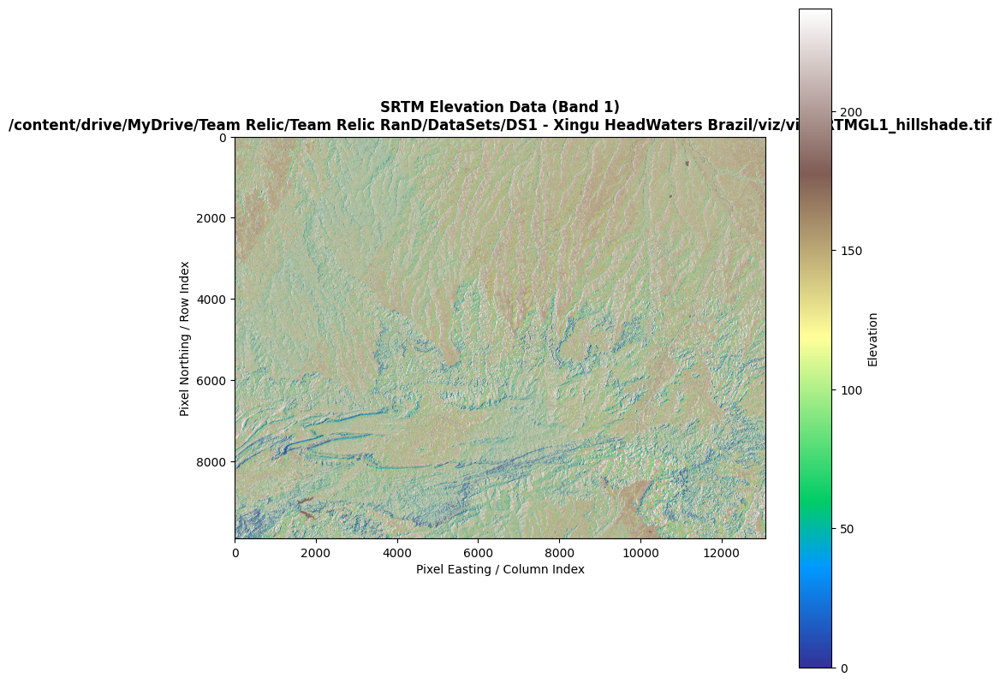


--- Basic Statistics (Band 1) ---
Using NoData value from metadata: 0.0
Min elevation: 1
Max elevation: 237
Mean elevation: 158.53338582168067


In [ ]:
# Snippet 4: Load and Inspect SRTM GeoTIFF Data(2 of 4)

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# IMPORTANT: Replace with the actual path to your GeoTIFF file in Google Drive
# This should be your main DEM file, likely named 'output_SRTMGL1.tif' or similar.
# Example: '/content/drive/MyDrive/OpenAI_Z_Challenge_Data/output_SRTMGL1.tif'
file_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/viz/viz.SRTMGL1_hillshade.tif' # <<< --- UPDATE THIS LINE

# This is for your Checkpoint 1 logging, based on your previous info
dataset_id_from_source = "SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)"

try:
    with rasterio.open(file_path) as src:
        print("Dataset opened successfully!")
        print(f"Dataset ID (for logging): {dataset_id_from_source}")
        print(f"File opened: {file_path}")
        print("--- Metadata ---")
        print(f"CRS: {src.crs}")
        print(f"Bounds: {src.bounds}")
        print(f"Width: {src.width} pixels, Height: {src.height} pixels")
        print(f"Number of bands: {src.count}")
        if src.count > 0:
            print(f"Data type of first band: {src.dtypes[0]}")
        else:
            print("No bands found in the dataset.")

        # Proceed only if there's at least one band
        if src.count > 0:
            # Read the first band (assuming elevation data is in the first band)
            data_band1 = src.read(1)

            # Basic visualization of the first band
            print("\n--- Basic Visualization (Band 1) ---")
            fig, ax = plt.subplots(1, 1, figsize=(10, 10)) # Increased figure size for better viewing
            show(data_band1, ax=ax, cmap='terrain', title=f'SRTM Elevation Data (Band 1)\n{file_path}')
            ax.set_xlabel("Pixel Easting / Column Index") # More descriptive labels
            ax.set_ylabel("Pixel Northing / Row Index")
            plt.colorbar(ax.images[0], ax=ax, label="Elevation") # Add a colorbar
            plt.show()

            print("\n--- Basic Statistics (Band 1) ---")
            # Attempt to use the actual NoData value from the raster's metadata
            nodata_val = src.nodata

            # If nodata is not set in metadata, you might need to know it or infer it.
            # For SRTM, it's often -32768 for the 16-bit integer version.
            # We'll check if it's None and use a common SRTM NoData if so.
            if nodata_val is None:
                print("Warning: NoData value not explicitly set in raster metadata. Assuming a common value if applicable (e.g., -32768 for SRTM int16).")
                # For this example, if nodata_val is None, we won't specifically filter,
                # as np.min/max/mean on the raw array will be calculated.
                # For more robust stats, ensure you know and handle the NoData value correctly.
                valid_data_for_stats = data_band1 # Use all data if nodata is not specified
            else:
                print(f"Using NoData value from metadata: {nodata_val}")
                valid_data_for_stats = data_band1[data_band1 != nodata_val]

            if valid_data_for_stats.size > 0:
                print(f"Min elevation: {valid_data_for_stats.min()}")
                print(f"Max elevation: {valid_data_for_stats.max()}")
                print(f"Mean elevation: {valid_data_for_stats.mean()}")
            else:
                # This case might occur if the entire array consists of NoData values,
                # or if nodata_val was None and data_band1 was empty (though src.read(1) would usually error earlier).
                print("No valid data found to calculate statistics (array might be empty or all NoData values).")
        else:
            print("Cannot perform analysis as no bands were found in the dataset.")

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'.")
    print("Please ensure:")
    print("1. You have downloaded the correct GeoTIFF file (e.g., 'output_SRTMGL1.tif').")
    print("2. You have uploaded it to your Google Drive.")
    print("3. The 'file_path' variable in this script accurately points to its location in your Google Drive.")
    print("   Example: '/content/drive/MyDrive/YourFolder/YourFile.tif'")
except rasterio.errors.RasterioIOError as e:
    print(f"ERROR: Could not open or read the raster file at '{file_path}'.")
    print(f"The file might be corrupted, not a valid GeoTIFF, or an issue with permissions.")
    print(f"Rasterio error: {e}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")
    print("Make sure the file path is correct and the file is a valid GeoTIFF.")

Dataset opened successfully!
Dataset ID (for logging): SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)
File opened: /content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/viz/viz.SRTMGL1_slope.tif
--- Metadata ---
CRS: EPSG:4326
Bounds: BoundingBox(left=-56.21847222220583, bottom=-15.120416666676615, right=-52.58458333331646, top=-12.367361111120694)
Width: 13082 pixels, Height: 9911 pixels
Number of bands: 1
Data type of first band: float32

--- Basic Visualization (Band 1) ---


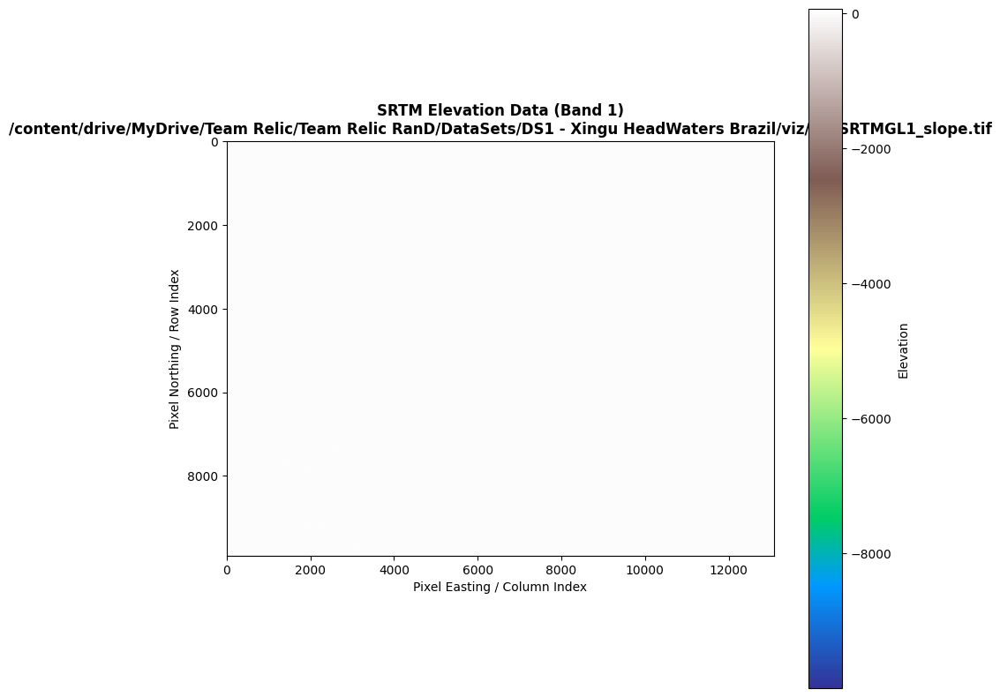


--- Basic Statistics (Band 1) ---
Using NoData value from metadata: -9999.0
Min elevation: 0.0
Max elevation: 67.53478240966797
Mean elevation: 3.254669427871704


In [ ]:
# Snippet 5: Load and Inspect SRTM GeoTIFF Data(3 of 4)

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# IMPORTANT: Replace with the actual path to your GeoTIFF file in Google Drive
# This should be your main DEM file, likely named 'output_SRTMGL1.tif' or similar.
# Example: '/content/drive/MyDrive/OpenAI_Z_Challenge_Data/output_SRTMGL1.tif'
file_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/viz/viz.SRTMGL1_slope.tif' # <<< --- UPDATE THIS LINE

# This is for your Checkpoint 1 logging, based on your previous info
dataset_id_from_source = "SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)"

try:
    with rasterio.open(file_path) as src:
        print("Dataset opened successfully!")
        print(f"Dataset ID (for logging): {dataset_id_from_source}")
        print(f"File opened: {file_path}")
        print("--- Metadata ---")
        print(f"CRS: {src.crs}")
        print(f"Bounds: {src.bounds}")
        print(f"Width: {src.width} pixels, Height: {src.height} pixels")
        print(f"Number of bands: {src.count}")
        if src.count > 0:
            print(f"Data type of first band: {src.dtypes[0]}")
        else:
            print("No bands found in the dataset.")

        # Proceed only if there's at least one band
        if src.count > 0:
            # Read the first band (assuming elevation data is in the first band)
            data_band1 = src.read(1)

            # Basic visualization of the first band
            print("\n--- Basic Visualization (Band 1) ---")
            fig, ax = plt.subplots(1, 1, figsize=(10, 10)) # Increased figure size for better viewing
            show(data_band1, ax=ax, cmap='terrain', title=f'SRTM Elevation Data (Band 1)\n{file_path}')
            ax.set_xlabel("Pixel Easting / Column Index") # More descriptive labels
            ax.set_ylabel("Pixel Northing / Row Index")
            plt.colorbar(ax.images[0], ax=ax, label="Elevation") # Add a colorbar
            plt.show()

            print("\n--- Basic Statistics (Band 1) ---")
            # Attempt to use the actual NoData value from the raster's metadata
            nodata_val = src.nodata

            # If nodata is not set in metadata, you might need to know it or infer it.
            # For SRTM, it's often -32768 for the 16-bit integer version.
            # We'll check if it's None and use a common SRTM NoData if so.
            if nodata_val is None:
                print("Warning: NoData value not explicitly set in raster metadata. Assuming a common value if applicable (e.g., -32768 for SRTM int16).")
                # For this example, if nodata_val is None, we won't specifically filter,
                # as np.min/max/mean on the raw array will be calculated.
                # For more robust stats, ensure you know and handle the NoData value correctly.
                valid_data_for_stats = data_band1 # Use all data if nodata is not specified
            else:
                print(f"Using NoData value from metadata: {nodata_val}")
                valid_data_for_stats = data_band1[data_band1 != nodata_val]

            if valid_data_for_stats.size > 0:
                print(f"Min elevation: {valid_data_for_stats.min()}")
                print(f"Max elevation: {valid_data_for_stats.max()}")
                print(f"Mean elevation: {valid_data_for_stats.mean()}")
            else:
                # This case might occur if the entire array consists of NoData values,
                # or if nodata_val was None and data_band1 was empty (though src.read(1) would usually error earlier).
                print("No valid data found to calculate statistics (array might be empty or all NoData values).")
        else:
            print("Cannot perform analysis as no bands were found in the dataset.")

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'.")
    print("Please ensure:")
    print("1. You have downloaded the correct GeoTIFF file (e.g., 'output_SRTMGL1.tif').")
    print("2. You have uploaded it to your Google Drive.")
    print("3. The 'file_path' variable in this script accurately points to its location in your Google Drive.")
    print("   Example: '/content/drive/MyDrive/YourFolder/YourFile.tif'")
except rasterio.errors.RasterioIOError as e:
    print(f"ERROR: Could not open or read the raster file at '{file_path}'.")
    print(f"The file might be corrupted, not a valid GeoTIFF, or an issue with permissions.")
    print(f"Rasterio error: {e}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")
    print("Make sure the file path is correct and the file is a valid GeoTIFF.")

Dataset opened successfully!
Dataset ID (for logging): SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)
File opened: /content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/output_SRTMGL1.tif
--- Metadata ---
CRS: EPSG:4326
Bounds: BoundingBox(left=-56.21847222220583, bottom=-15.120416666676615, right=-52.58458333331646, top=-12.367361111120694)
Width: 13082 pixels, Height: 9911 pixels
Number of bands: 1
Data type of first band: int16

--- Basic Visualization (Band 1) ---


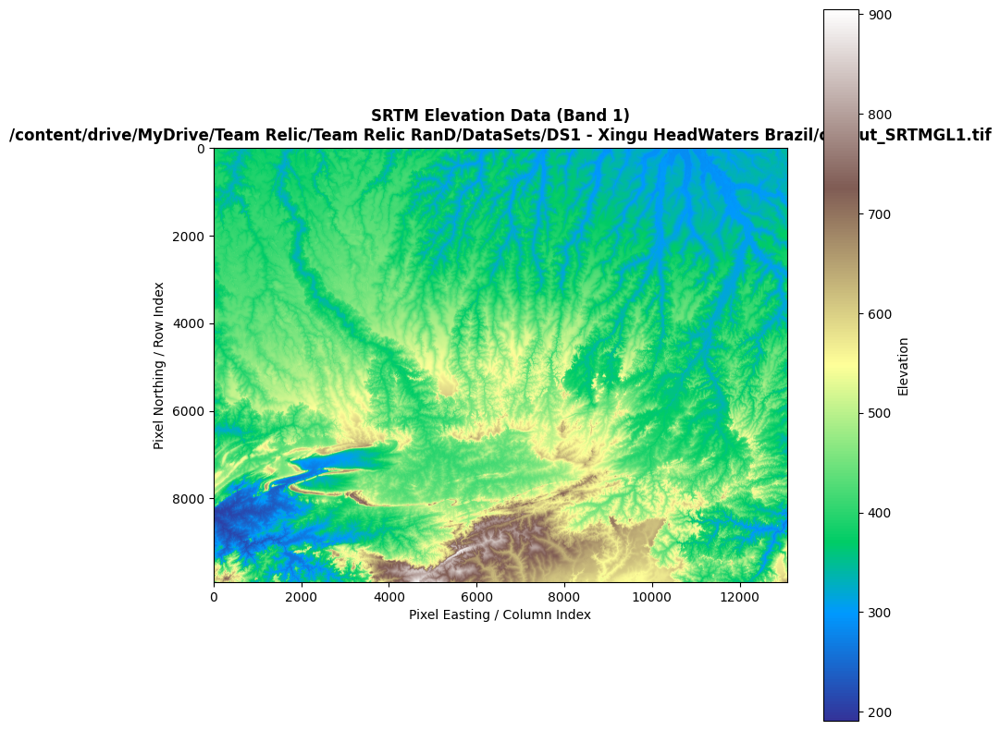


--- Basic Statistics (Band 1) ---
Using NoData value from metadata: -32768.0
Min elevation: 191
Max elevation: 905
Mean elevation: 427.1885403774992


In [ ]:
# Snippet 6: Load and Inspect SRTM GeoTIFF Data( 4 of 4)

import rasterio
from rasterio.plot import show
import matplotlib.pyplot as plt

# IMPORTANT: Replace with the actual path to your GeoTIFF file in Google Drive
# This should be your main DEM file, likely named 'output_SRTMGL1.tif' or similar.
# Example: '/content/drive/MyDrive/OpenAI_Z_Challenge_Data/output_SRTMGL1.tif'
file_path = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/output_SRTMGL1.tif' # <<< --- UPDATE THIS LINE

# This is for your Checkpoint 1 logging, based on your previous info
dataset_id_from_source = "SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)"

try:
    with rasterio.open(file_path) as src:
        print("Dataset opened successfully!")
        print(f"Dataset ID (for logging): {dataset_id_from_source}")
        print(f"File opened: {file_path}")
        print("--- Metadata ---")
        print(f"CRS: {src.crs}")
        print(f"Bounds: {src.bounds}")
        print(f"Width: {src.width} pixels, Height: {src.height} pixels")
        print(f"Number of bands: {src.count}")
        if src.count > 0:
            print(f"Data type of first band: {src.dtypes[0]}")
        else:
            print("No bands found in the dataset.")

        # Proceed only if there's at least one band
        if src.count > 0:
            # Read the first band (assuming elevation data is in the first band)
            data_band1 = src.read(1)

            # Basic visualization of the first band
            print("\n--- Basic Visualization (Band 1) ---")
            fig, ax = plt.subplots(1, 1, figsize=(10, 10)) # Increased figure size for better viewing
            show(data_band1, ax=ax, cmap='terrain', title=f'SRTM Elevation Data (Band 1)\n{file_path}')
            ax.set_xlabel("Pixel Easting / Column Index") # More descriptive labels
            ax.set_ylabel("Pixel Northing / Row Index")
            plt.colorbar(ax.images[0], ax=ax, label="Elevation") # Add a colorbar
            plt.show()

            print("\n--- Basic Statistics (Band 1) ---")
            # Attempt to use the actual NoData value from the raster's metadata
            nodata_val = src.nodata

            # If nodata is not set in metadata, you might need to know it or infer it.
            # For SRTM, it's often -32768 for the 16-bit integer version.
            # We'll check if it's None and use a common SRTM NoData if so.
            if nodata_val is None:
                print("Warning: NoData value not explicitly set in raster metadata. Assuming a common value if applicable (e.g., -32768 for SRTM int16).")
                # For this example, if nodata_val is None, we won't specifically filter,
                # as np.min/max/mean on the raw array will be calculated.
                # For more robust stats, ensure you know and handle the NoData value correctly.
                valid_data_for_stats = data_band1 # Use all data if nodata is not specified
            else:
                print(f"Using NoData value from metadata: {nodata_val}")
                valid_data_for_stats = data_band1[data_band1 != nodata_val]

            if valid_data_for_stats.size > 0:
                print(f"Min elevation: {valid_data_for_stats.min()}")
                print(f"Max elevation: {valid_data_for_stats.max()}")
                print(f"Mean elevation: {valid_data_for_stats.mean()}")
            else:
                # This case might occur if the entire array consists of NoData values,
                # or if nodata_val was None and data_band1 was empty (though src.read(1) would usually error earlier).
                print("No valid data found to calculate statistics (array might be empty or all NoData values).")
        else:
            print("Cannot perform analysis as no bands were found in the dataset.")

except FileNotFoundError:
    print(f"ERROR: File not found at '{file_path}'.")
    print("Please ensure:")
    print("1. You have downloaded the correct GeoTIFF file (e.g., 'output_SRTMGL1.tif').")
    print("2. You have uploaded it to your Google Drive.")
    print("3. The 'file_path' variable in this script accurately points to its location in your Google Drive.")
    print("   Example: '/content/drive/MyDrive/YourFolder/YourFile.tif'")
except rasterio.errors.RasterioIOError as e:
    print(f"ERROR: Could not open or read the raster file at '{file_path}'.")
    print(f"The file might be corrupted, not a valid GeoTIFF, or an issue with permissions.")
    print(f"Rasterio error: {e}")
except Exception as e:
    print(f"An unexpected error occurred: {e}")
    print("Make sure the file path is correct and the file is a valid GeoTIFF.")

In [ ]:
# Snippet 7
if 'client' in locals() and OPENAI_API_KEY is not None: # Check if client is initialized
    # Customize this description based on your data and the Kuhikugu/Xingu area context
    terrain_description = (
        "The SRTM DEM data for the Xingu River headwaters region in the Amazon, "
        "known to be near the Kuhikugu archaeological complex, reveals a generally flat to undulating terrain. "
        "Subtle, regular patterns, including linear and geometric earthworks (mounds, ditches, raised fields, roads), "
        "are historically documented and potentially visible as slight elevation changes. "
        "The area features a mix of forest cover and some areas of past or present clearing. "
        "Kuhikugu itself is characterized by a network of interconnected settlements."
    )

    prompt_to_openai = (
        f"Considering the following terrain description from an Amazonian region historically associated with "
        f"complex pre-Columbian societies like those that created Kuhikugu: '{terrain_description}'\n\n"
        f"1. Based *only* on this type of terrain description (derived from SRTM-level elevation data), "
        f"what specific kinds of subtle topographical features or patterns would an archaeologist look for as potential indicators "
        f"of previously undiscovered ancient human settlements, roads, or agricultural systems in such an environment?\n"
        f"2. How might the limitations of SRTM data (e.g., resolution, vegetation penetration) affect the reliable "
        f"identification of these features?"
    )

    chosen_model = "gpt-4o" # Or "gpt-4-turbo", or a specific o3/o4 mini model if you have access and it's suitable

    print(f"--- Sending Prompt to OpenAI Model ({chosen_model}) ---")
    print(f"Prompt:\n{prompt_to_openai}\n")

    try:
        response = client.chat.completions.create(
            model=chosen_model,
            messages=[
                {"role": "system", "content": "You are an AI assistant knowledgeable in archaeology and remote sensing interpretation in Amazonia."},
                {"role": "user", "content": prompt_to_openai}
            ],
            max_tokens=500, # Adjust as needed
            temperature=0.5  # Adjust for creativity vs. factuality
        )

        ai_response_content = response.choices[0].message.content
        print("--- AI Model Response ---")
        print(ai_response_content)

        # For Checkpoint 1 logging
        model_version_used = chosen_model # Or more specific if available from response object, though often it's what you requested.
                                        # The response object itself might contain model fingerprint.
                                        # For example: response.model could give the full model string.
        if hasattr(response, 'model') and response.model:
             model_version_used = response.model

    except Exception as e:
        print(f"An error occurred while calling the OpenAI API: {e}")
        ai_response_content = None # Ensure it's defined
        model_version_used = chosen_model # Default if API call failed before getting response.model
else:
    print("OpenAI client not initialized. Please run Snippet 2 successfully first.")
    ai_response_content = None
    model_version_used = "N/A (API call not made)"

--- Sending Prompt to OpenAI Model (gpt-4o) ---
Prompt:
Considering the following terrain description from an Amazonian region historically associated with complex pre-Columbian societies like those that created Kuhikugu: 'The SRTM DEM data for the Xingu River headwaters region in the Amazon, known to be near the Kuhikugu archaeological complex, reveals a generally flat to undulating terrain. Subtle, regular patterns, including linear and geometric earthworks (mounds, ditches, raised fields, roads), are historically documented and potentially visible as slight elevation changes. The area features a mix of forest cover and some areas of past or present clearing. Kuhikugu itself is characterized by a network of interconnected settlements.'

1. Based *only* on this type of terrain description (derived from SRTM-level elevation data), what specific kinds of subtle topographical features or patterns would an archaeologist look for as potential indicators of previously undiscovered ancient h

In [ ]:
# Snippet 8 This information should be logged for Checkpoint 1

print("\n--- Checkpoint 1 Logging Information ---")
print(f"Dataset ID Used: {dataset_id_from_source}") # From Snippet 3
print(f"OpenAI Model Version Used: {model_version_used}") # From Snippet 4

if ai_response_content:
    print("OpenAI Prompt and Response successfully logged (see output from Snippet 4).")
else:
    print("OpenAI API call was not successful or not made. Prompt and response not available.")

print("\nReminder: Ensure you have documented your first OpenAI prompt (see Snippet 4 output).")


--- Checkpoint 1 Logging Information ---
Dataset ID Used: SRTM GL1 - OpenTopography JobId rt1748684172986 (Xingu River Area, specifically output_SRTMGL1.tif or similar DEM)
OpenAI Model Version Used: gpt-4o-2024-08-06
OpenAI Prompt and Response successfully logged (see output from Snippet 4).

Reminder: Ensure you have documented your first OpenAI prompt (see Snippet 4 output).


In [ ]:
# Snippet S1: Define Paths to Your Renamed Sentinel-2 Bands
# (Run this cell after Snippet 1 & 2 from our previous work are already run in your notebook)

import os # Used for joining path components if needed

# --- IMPORTANT: VERIFY THIS BASE PATH AND FILENAMES ---
# Based on the path you provided, this is the direct path to the R10m folder.
# Ensure this full path is exactly correct and that your band files are inside it.
path_to_r10m_folder = '/content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m'

# Adjust these filenames to EXACTLY match what you have in your R10m folder in Google Drive
# You used "Tile1_B02_10m.jp2", "Tile2_B03_10m.jp2", "Tile3_B04_10m.jp2", "Tile4_B08_10m.jp2"
# Ensure these are the correct band assignments (B02 for Blue, B03 for Green, etc.)
# It's more common for all bands from THE SAME TILE to have the same tile prefix,
# e.g., Tile1_B02, Tile1_B03, Tile1_B04, Tile1_B08. Please verify your naming.
# For this example, I'll assume you want to use the B02, B03, B04, B08 bands and
# you'll ensure the "TileX_" prefix correctly corresponds to the band type.
# Let's assume you have files named consistently for one tile, e.g., 'YourTilePrefix_Band_Resolution.jp2'

# ** PLEASE VERIFY AND CORRECT THESE FILENAMES AS NEEDED **
# If your B02 (Blue) band file is named 'Tile1_B02_10m.jp2':
s2_b02_path = os.path.join(path_to_r10m_folder, 'Tile1_B02_10m.jp2') # Blue band
# If your B03 (Green) band file is named 'Tile2_B03_10m.jp2':
s2_b03_path = os.path.join(path_to_r10m_folder, 'Tile2_B03_10m.jp2') # Green band
# If your B04 (Red) band file is named 'Tile3_B04_10m.jp2':
s2_b04_path = os.path.join(path_to_r10m_folder, 'Tile3_B04_10m.jp2') # Red band
# If your B08 (NIR) band file is named 'Tile4_B08_10m.jp2':
s2_b08_path = os.path.join(path_to_r10m_folder, 'Tile4_B08_10m.jp2') # Near Infrared band


# Check if the folder and files exist
print(f"Checking path to R10m folder: {path_to_r10m_folder} - Folder Exists: {os.path.exists(path_to_r10m_folder)}")
print(f"Path for B02: {s2_b02_path} - Exists: {os.path.exists(s2_b02_path)}")
print(f"Path for B03: {s2_b03_path} - Exists: {os.path.exists(s2_b03_path)}")
print(f"Path for B04: {s2_b04_path} - Exists: {os.path.exists(s2_b04_path)}")
print(f"Path for B08: {s2_b08_path} - Exists: {os.path.exists(s2_b08_path)}")

# --- If you have a SECOND Sentinel-2 tile, define its paths similarly ---
# For now, we will focus on processing one set of B02, B03, B04, B08 bands.


Checking path to R10m folder: /content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m - Folder Exists: True
Path for B02: /content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m/Tile1_B02_10m.jp2 - Exists: True
Path for B03: /content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DATA/R10m/Tile2_B03_10m.jp2 - Exists: True
Path for B04: /content/drive/MyDrive/Team Relic/Team Relic RanD/DataSets/DS1 - Xingu HeadWaters Brazil/S2A_MSIL2A_20250603T135131_N0511_R024_T21LZG_20250603T153613.SAFE/GRANULE/L2A_T21LZG_A051959_20250603T135127/IMG_DA

In [ ]:
# Snippet S2: Load Sentinel-2 Bands using Rasterio
# (Run this after Snippet S1)

import rasterio
import numpy as np # We'll need numpy for stacking and calculations

# --- Load Bands for Tile 1 ---
# Ensure the paths from Snippet S1 are correct and the files exist

# Initialize band variables to None in case of errors
b02, b03, b04, b08 = None, None, None, None
s2_profile, s2_crs, s2_transform = None, None, None

try:
    # Open and read each band
    with rasterio.open(s2_b02_path) as src_b02:
        b02 = src_b02.read(1).astype('float32') # Blue
        s2_profile = src_b02.profile # Save profile for writing later if needed
        s2_crs = src_b02.crs
        s2_transform = src_b02.transform

    with rasterio.open(s2_b03_path) as src_b03:
        b03 = src_b03.read(1).astype('float32') # Green

    with rasterio.open(s2_b04_path) as src_b04:
        b04 = src_b04.read(1).astype('float32') # Red

    with rasterio.open(s2_b08_path) as src_b08:
        b08 = src_b08.read(1).astype('float32') # Near Infrared

    print("Sentinel-2 bands B02, B03, B04, and B08 loaded successfully for Tile 1.")
    if b02 is not None:
        print(f"Shape of band arrays (e.g., B02): {b02.shape}")
    if s2_crs is not None:
        print(f"Coordinate Reference System (CRS): {s2_crs}")

    # --- Optional: Basic stats for one band to understand value range ---
    # Sentinel-2 L2A surface reflectance values are typically scaled (e.g., 0-10000 or similar)
    # They are not 0-255 like a standard image initially.
    if b04 is not None:
        print(f"\nStats for raw B04 (Red band) before scaling for display:")
        print(f"Min: {np.nanmin(b04)}, Max: {np.nanmax(b04)}, Mean: {np.nanmean(b04)}")

except FileNotFoundError as fnf_error:
    print(f"ERROR: A Sentinel-2 band file was not found. Please check paths in Snippet S1.")
    print(f"Details: {fnf_error}")
except Exception as e:
    print(f"An error occurred while loading Sentinel-2 bands: {e}")


Sentinel-2 bands B02, B03, B04, and B08 loaded successfully for Tile 1.
Shape of band arrays (e.g., B02): (10980, 10980)
Coordinate Reference System (CRS): EPSG:32721

Stats for raw B04 (Red band) before scaling for display:
Min: 764.0, Max: 9968.0, Mean: 1262.5869140625


True-Color Composite created.
Shape of TCC: (10980, 10980, 3)


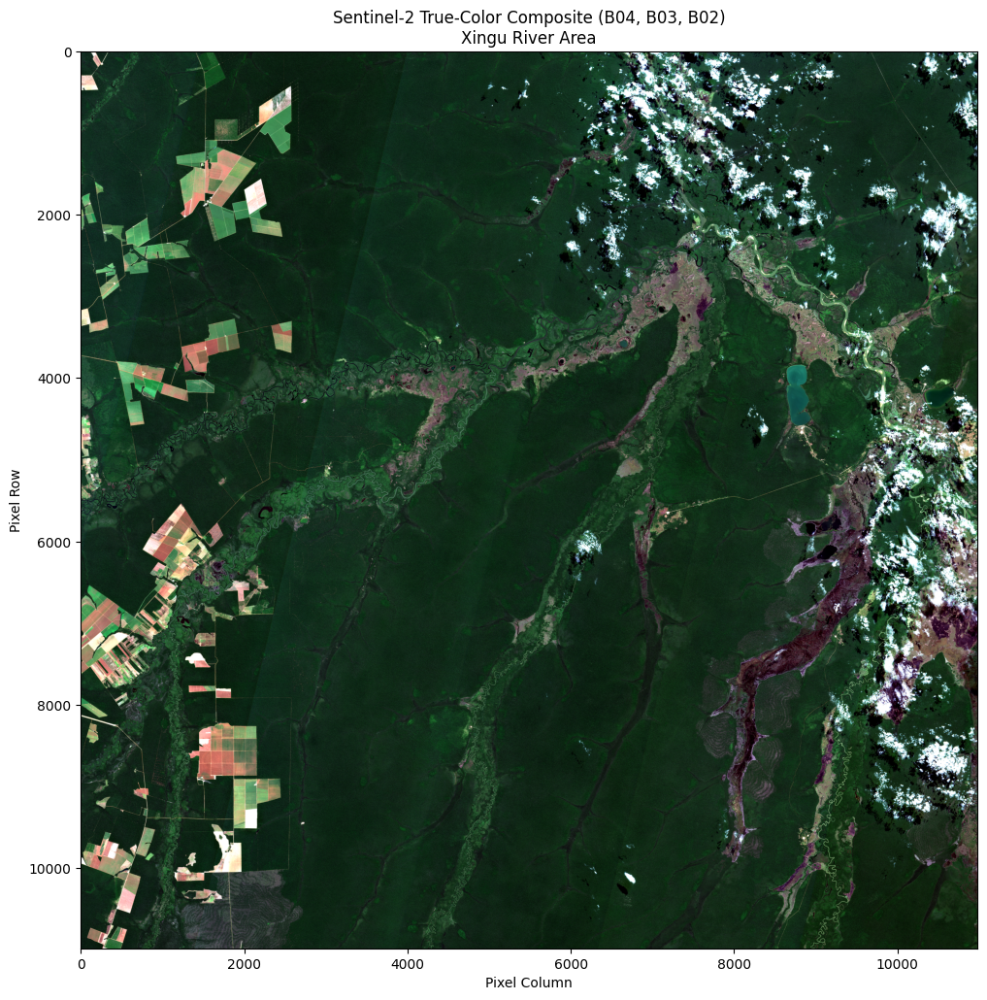

In [ ]:
# Snippet S3: Create and Visualize True-Color Composite (TCC)
# (Run this after Snippet S2)

import matplotlib.pyplot as plt

# Function to scale band data for visualization (0-1 range)
# This is a simple percentile stretch, common for enhancing satellite imagery.
def scale_band(band_data, lower_percent=2, upper_percent=98):
    # Ensure band_data is not None and has data
    if band_data is None or band_data.size == 0:
        print("Warning: band_data is empty or None in scale_band function.")
        return np.zeros_like(band_data) if band_data is not None else None # Return zeros or None

    # Check for all NaN values, which can cause percentile issues
    if np.all(np.isnan(band_data)):
        print("Warning: band_data contains all NaN values.")
        # If all NaNs, return an array of zeros or NaNs of the same shape
        # to avoid errors in stacking later.
        return np.full_like(band_data, np.nan)


    a = np.nanpercentile(band_data, lower_percent)
    b = np.nanpercentile(band_data, upper_percent)

    # Avoid division by zero if a and b are the same (e.g., flat image or after NaN handling)
    if (b - a) == 0:
        # Handle flat image case: scale to 0 or 0.5, or return as is if values are already 0-1
        # If a and b are the same, it means a flat image at that value.
        # We'll scale it to 0 for display consistency, or you might choose another strategy.
        # Or, if a and b are NaN (from all NaN input), return NaNs
        if np.isnan(a) or np.isnan(b):
            return np.full_like(band_data, np.nan)
        return np.zeros_like(band_data) + (a if 0 <= a <= 1 else 0)


    scaled_band = (band_data - a) / (b - a)
    scaled_band = np.clip(scaled_band, 0, 1)
    return scaled_band

try:
    if b04 is not None and b03 is not None and b02 is not None:
        # Scale the bands for true-color display
        r_scaled = scale_band(b04) # Red band
        g_scaled = scale_band(b03) # Green band
        b_scaled = scale_band(b02) # Blue band

        if r_scaled is not None and g_scaled is not None and b_scaled is not None:
            # Stack the R, G, B bands to create the true-color composite
            true_color_composite = np.stack([r_scaled, g_scaled, b_scaled], axis=-1)

            print("True-Color Composite created.")
            print(f"Shape of TCC: {true_color_composite.shape}")

            # Display the True-Color Composite
            plt.figure(figsize=(12, 12))
            plt.imshow(true_color_composite)
            plt.title("Sentinel-2 True-Color Composite (B04, B03, B02)\nXingu River Area") # Removed "Tile 1" for generality
            plt.xlabel("Pixel Column")
            plt.ylabel("Pixel Row")
            plt.axis('on')
            plt.show()
        else:
            print("ERROR: Scaling of one or more bands for TCC failed (resulted in None).")
    else:
        print("ERROR: One or more required bands (B02, B03, B04) were not loaded in Snippet S2.")

except Exception as e:
    print(f"An error occurred during True-Color Composite creation or display: {e}")


False-Color Composite created.
Shape of FCC: (10980, 10980, 3)


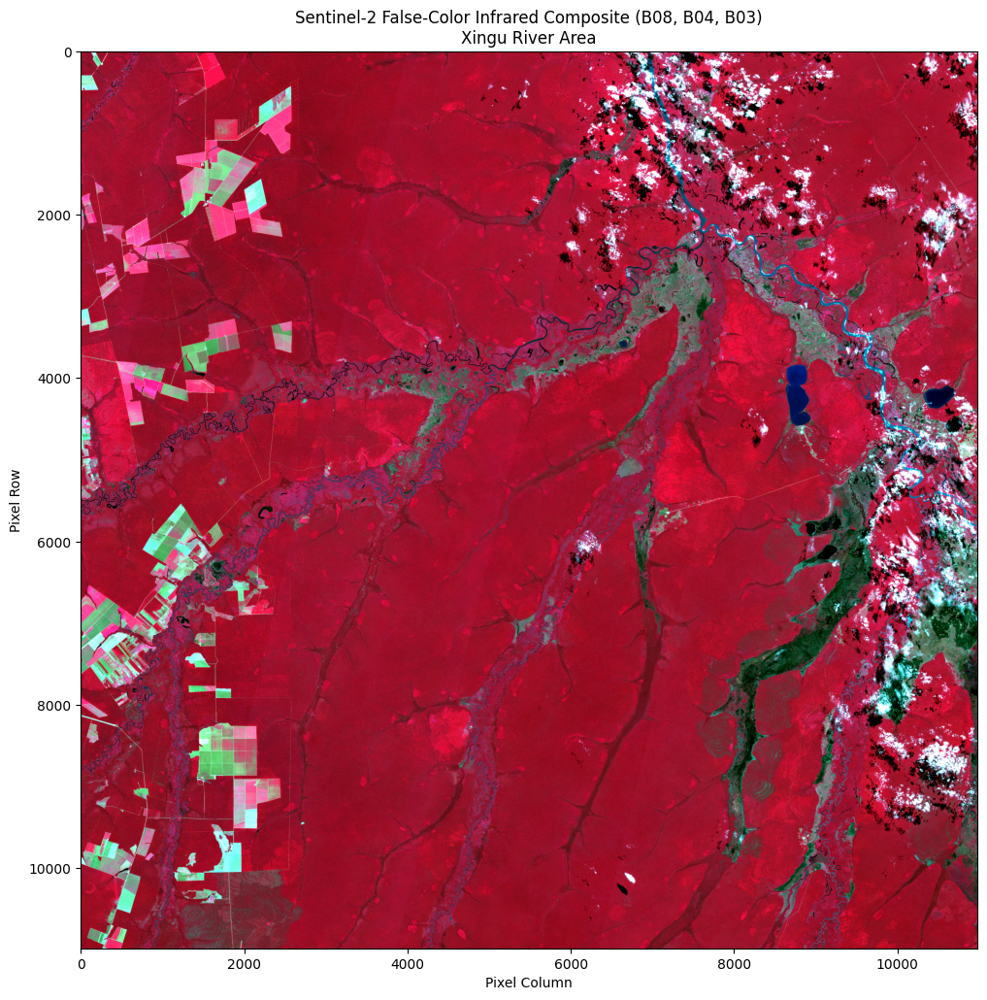

In [ ]:
# Snippet S4: Create and Visualize False-Color Infrared Composite (FCC / CIR)
# (Run this after Snippet S2 and Snippet S3 to ensure r_scaled and g_scaled are available)

# We will use the same scale_band function from Snippet S3

try:
    if b08 is not None and b04 is not None and b03 is not None:
        # Scale the bands for false-color display
        nir_scaled = scale_band(b08) # Near Infrared band

        # r_scaled and g_scaled should be available if Snippet S3 ran successfully
        # For robustness, we check if they exist or re-calculate if they were None:
        if 'r_scaled' not in locals() or r_scaled is None: # Check if variable exists and is not None
            r_scaled = scale_band(b04)
        if 'g_scaled' not in locals() or g_scaled is None: # Check if variable exists and is not None
            g_scaled = scale_band(b03)

        if nir_scaled is not None and r_scaled is not None and g_scaled is not None:
            # Stack the NIR, R, G bands to create the false-color composite
            false_color_composite = np.stack([nir_scaled, r_scaled, g_scaled], axis=-1)

            print("False-Color Composite created.")
            print(f"Shape of FCC: {false_color_composite.shape}")

            # Display the False-Color Composite
            plt.figure(figsize=(12, 12))
            plt.imshow(false_color_composite)
            plt.title("Sentinel-2 False-Color Infrared Composite (B08, B04, B03)\nXingu River Area") # Removed "Tile 1"
            plt.xlabel("Pixel Column")
            plt.ylabel("Pixel Row")
            plt.axis('on')
            plt.show()
        else:
            print("ERROR: Scaling of one or more bands for FCC failed (resulted in None).")
    else:
        print("ERROR: One or more required bands (B08, B04, B03) were not loaded in Snippet S2.")

except Exception as e:
    print(f"An error occurred during False-Color Composite creation or display: {e}")


In [ ]:
# June 6th, 2025 - GasMan
# Snippet 5 Second Session
# Ensure the 'client' variable from Snippet 2 is available

if 'client' in locals() and OPENAI_API_KEY is not None:
    # This description is based on the True-Color and False-Color images you generated.
    # Feel free to edit or add your own observations to make it more specific!
    image_description = (
        "I have processed Sentinel-2 L2A data for the Xingu River headwaters. "
        "The True-Color Composite (B4,B3,B2) shows large areas of very dense, dark green forest. "
        "This is interspersed with numerous patches of lighter green and tan/brown, many of which have sharp, geometric (rectangular) boundaries, indicating modern deforestation for agriculture or pasture. "
        "The river system is visible as brownish, sediment-laden water. "
        "The False-Color Infrared Composite (B8,B4,B3) confirms these observations: "
        "The dense forest appears as a deep, vibrant red, indicating healthy vegetation. "
        "The deforested patches appear in contrasting colors like bright cyan, light green, or pinkish-white. "
        "Water bodies stand out as very dark blue or black."
    )

    my_questions = (
        "1. Based on the description above of a Sentinel-2 scene from the Xingu River area, how can a False-Color Infrared (B8,B4,B3) image be specifically used to identify potential archaeological anomalies that might be hidden *within* the densely forested (bright red) areas? What subtle variations in the red tones should I be looking for?\n\n"
        "2. For the areas that are already deforested (the cyan/light green patches), what kinds of patterns, shapes, or soil color differences should I look for in the True-Color image that might reveal previously hidden earthworks now exposed by the clearing?"
    )

    prompt_to_openai = (
        f"I am conducting an archaeological analysis. Here is a description of my Sentinel-2 satellite imagery and my questions:\n\n"
        f"Image Description:\n{image_description}\n\n"
        f"My Questions:\n{my_questions}"
    )

    chosen_model = "gpt-4o"

    print(f"--- Sending New Prompt to OpenAI Model ({chosen_model}) ---")
    print(f"Prompt:\n{prompt_to_openai}\n")

    try:
        response = client.chat.completions.create(
            model=chosen_model,
            messages=[
                {"role": "system", "content": "You are an expert AI assistant in Amazonian archaeology and the interpretation of multispectral satellite imagery like Sentinel-2."},
                {"role": "user", "content": prompt_to_openai}
            ],
            max_tokens=600, # Increased tokens slightly for a more detailed answer
            temperature=0.5
        )

        # Log this new response in a new variable to keep it separate from the first one
        ai_response_2_content = response.choices[0].message.content
        model_version_used_2 = response.model

        print("--- AI Model Response ---")
        print(ai_response_2_content)

    except Exception as e:
        print(f"An error occurred while calling the OpenAI API: {e}")
        ai_response_2_content = None
        model_version_used_2 = chosen_model

else:
    print("OpenAI client not initialized. Please run Snippet 2 successfully first.")
    ai_response_2_content = None
    model_version_used_2 = "N/A (API call not made)"

--- Sending New Prompt to OpenAI Model (gpt-4o) ---
Prompt:
I am conducting an archaeological analysis. Here is a description of my Sentinel-2 satellite imagery and my questions:

Image Description:
I have processed Sentinel-2 L2A data for the Xingu River headwaters. The True-Color Composite (B4,B3,B2) shows large areas of very dense, dark green forest. This is interspersed with numerous patches of lighter green and tan/brown, many of which have sharp, geometric (rectangular) boundaries, indicating modern deforestation for agriculture or pasture. The river system is visible as brownish, sediment-laden water. The False-Color Infrared Composite (B8,B4,B3) confirms these observations: The dense forest appears as a deep, vibrant red, indicating healthy vegetation. The deforested patches appear in contrasting colors like bright cyan, light green, or pinkish-white. Water bodies stand out as very dark blue or black.

My Questions:
1. Based on the description above of a Sentinel-2 scene from t

In [ ]:
# Snippet 6 Second Session: Re-Prompting AI with a Specific Anomaly Finding
# (Run this snippet AFTER you have visually identified a potential anomaly)

# --- IMPORTANT: FILL IN THE DETAILS BELOW BASED ON YOUR FINDING ---

# 1. Define the location of your potential anomaly
anomaly_coordinates = "e.g., Approximately at Latitude -13.55, Longitude -54.78"

# 2. Describe what you see in your different data layers for that location
anomaly_description = """
In the SRTM hillshade, I see a subtle, unusually straight linear depression, approximately 400 meters long, running east-west. It appears to connect two slightly elevated, flatter areas.
In the Sentinel-2 False-Color image, the vibrant red of the healthy forest shows a faint, slightly darker red linear pattern that aligns perfectly with the depression seen in the hillshade.
"""

# 3. Formulate your specific questions for the AI
my_questions = """
1. Based on these combined observations from both topographic (SRTM) and multispectral (Sentinel-2) data, what is the likelihood that this is an anthropogenic (man-made) feature?
2. What are the most plausible interpretations for such a feature in the context of Xingu "garden city" cultures (e.g., a pathway, a defensive ditch, a canal, a boundary marker)?
3. What other specific features should I look for in the immediate vicinity of this linear depression that might support one interpretation over another?
"""

# --- This part of the snippet sends the prompt to the AI ---

if 'client' in locals() and OPENAI_API_KEY is not None:
    prompt_to_openai_2 = (
        f"I am analyzing a specific location within my Xingu River study area.\n\n"
        f"Location of Potential Anomaly:\n{anomaly_coordinates}\n\n"
        f"My Observations from Geospatial Data:\n{anomaly_description}\n\n"
        f"My Questions:\n{my_questions}"
    )

    chosen_model = "gpt-4o"

    print(f"--- Sending Leveraged Prompt to OpenAI Model ({chosen_model}) ---")
    print(f"Prompt:\n{prompt_to_openai_2}\n")

    try:
        response = client.chat.completions.create(
            model=chosen_model,
            messages=[
                {"role": "system", "content": "You are an expert AI assistant in Amazonian archaeology and the interpretation of remote sensing data."},
                {"role": "user", "content": prompt_to_openai_2}
            ],
            max_tokens=600,
            temperature=0.5
        )

        ai_response_3_content = response.choices[0].message.content
        model_version_used_3 = response.model

        print("--- AI Model Response ---")
        print(ai_response_3_content)

    except Exception as e:
        print(f"An error occurred while calling the OpenAI API: {e}")
        ai_response_3_content = None
        model_version_used_3 = chosen_model

else:
    print("OpenAI client not initialized. Please run Snippet 2 successfully first.")
    ai_response_3_content = None
    model_version_used_3 = "N/A (API call not made)"

--- Sending Leveraged Prompt to OpenAI Model (gpt-4o) ---
Prompt:
I am analyzing a specific location within my Xingu River study area.

Location of Potential Anomaly:
e.g., Approximately at Latitude -13.55, Longitude -54.78

My Observations from Geospatial Data:

In the SRTM hillshade, I see a subtle, unusually straight linear depression, approximately 400 meters long, running east-west. It appears to connect two slightly elevated, flatter areas.
In the Sentinel-2 False-Color image, the vibrant red of the healthy forest shows a faint, slightly darker red linear pattern that aligns perfectly with the depression seen in the hillshade.


My Questions:

1. Based on these combined observations from both topographic (SRTM) and multispectral (Sentinel-2) data, what is the likelihood that this is an anthropogenic (man-made) feature?
2. What are the most plausible interpretations for such a feature in the context of Xingu "garden city" cultures (e.g., a pathway, a defensive ditch, a canal, a bo